<div>
<h1 style="background-color:#82e0aa   ;padding:20px;border-radius:10px;border:3px solid #3339ff;color:#21618c  ;text-align:center; font-family: Babas; font-size: 2.5em;" > Anticipation of Building Consumption Needs in Seattle |  Energy Consumption modelling

<img src="https://login.seattle.gov/static/media/logo.62be6fde.jpg"/></h1>
</div>

The City of Seattle's aim is to achieve carbon neutrality by 2050. To accomplish this goal, the city is focusing on the energy consumption and CO2 emissions of non-residential buildings.

Non-residential buildings, such as commercial, industrial, and institutional structures, can have a significant impact on energy consumption and greenhouse gas emissions. Here are some steps that the city could take to address this issue:

The consumption and emissions of non-residential buildings can play a significant role in the transition towards a carbon-neutral city.

In order to achieve carbon neutrality, it is important to consider additional factors identified in studies conducted by experts and researchers. These factors include:


* **Energy performance assessment:** Conduct thorough evaluations of the energy performance of non-residential buildings to identify areas where improvements can be made. This may include energy audits, energy consumption monitoring systems, and identification of inefficient equipment.

* **Promotion of energy efficiency:** mplement incentives and subsidy programs to encourage owners of non-residential buildings to adopt energy-efficient measures. This can include financial incentives for the installation of efficient heating and cooling systems, improved insulation, LED lighting, and other energy-saving technologies.

* **Use of renewable energy sources:** Encourage the adoption of renewable energy sources to power non-residential buildings. This can involve green energy purchase programs, incentives for installing solar panels or wind turbines on building rooftops, and partnerships with renewable energy providers

* **Awareness and education:** Establish awareness campaigns to inform owners of non-residential buildings about the benefits of reducing energy consumption and emissions. This can include seminars, workshops, and online resources to help them make informed decisions on implementing energy efficiency measures.

* **Regulations and standards:** Review existing regulations and consider introducing new sustainable construction standards for non-residential buildings. This may include requirements for energy efficiency, heating and cooling system performance, and the use of environmentally friendly materials.

By considering these additional factors and incorporating them into strategies and policies, cities can strengthen their efforts towards achieving carbon neutrality. It is crucial to stay informed about the latest research findings and adapt approaches accordingly to maximize the effectiveness of carbon reduction efforts.

However, achieving such a goal can be costly since it implies reporting each month the consumption and CO2 emissions of the buildings in question. To address this issue, we have at our disposal. The aim of this project is to use the existing data to predict CO2 emissions and total energy consumption for non-residential buildings where they haven't been measured yet.

This project is build on three notebook:

- **Exploratory Data Analysis**

- **Energy Consumption prediction**

- **CO2 Emissions prediction**

In this project, all the model are building by taking into account the dataleakage.


<a id="IR"></a>
<h1 style="background-color:#82e0aa ;padding:18px;border-radius:10px;border:3px solid #3339ff;color:#21618c;text-align:center" > Libraries and Data loading </h1>

<a id="imp"></a>
## <span style="color:#33afff  ;"> Librairies import </span>

In [1]:
# Library for ML
import os
import time
import pickle
from scipy.stats import uniform
from textwrap import wrap
import ipywidgets as widgets

#Data
import numpy as np
import pandas as pd
import numpy as np

#Estimators
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge, SGDRegressor, ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
#from tpot import TPOTRegressor
from sklearn.base import clone

#preprocessing
from sklearn.preprocessing import   LabelEncoder, OneHotEncoder
from sklearn.preprocessing import *
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.compose import make_column_transformer, TransformedTargetRegressor
from sklearn.preprocessing import StandardScaler, RobustScaler, minmax_scale, power_transform, scale, normalize

#metrics
from sklearn.metrics import *
from sklearn.utils import check_array
from sklearn.metrics import mean_squared_error, mean_absolute_error, make_scorer, r2_score

# Pipelines building
from sklearn.base import TransformerMixin, RegressorMixin
from sklearn.base import BaseEstimator
from sklearn.pipeline import FeatureUnion


# Transformateurs de variables

from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.feature_extraction import FeatureHasher

# Cross validation 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate


#model selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, StratifiedShuffleSplit, StratifiedKFold, KFold, ShuffleSplit, StratifiedKFold, StratifiedShuffleSplit, StratifiedGroupKFold
import optuna 
from skopt.space import Real, Categorical, Integer 
from skopt import BayesSearchCV
from hyperopt import fmin, rand, hp, STATUS_OK, Trials, plotting, tpe, atpe, anneal
from sklearn.base import clone

# vizualisation
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_tabular
import shap

# typing

from typing import Dict, List, Tuple, Any


# Suppress all warnings
import warnings
warnings.filterwarnings("ignore")

#columns display

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

<a id="dl"></a>
## <span style="color:#33afff  ;"> Data loading </span>

In [2]:
data = pd.read_csv("data.csv")

<a href="#toc" role="button" aria-pressed="true" >⬆️    Back to top    ⬆️</a>

<a id="dp"></a>

<h1 style="background-color:#82e0aa ;padding:18px;border-radius:10px;border:3px solid #3339ff;color:#21618c;text-align:center" >Data Preparation</h1>


<a id="basic"></a>
## <span style="color:#33afff  ;">  Features selection </span>


In [3]:
def preprocessing(df: pd.DataFrame) -> pd.DataFrame:
    """
    Perform preprocessing on a DataFrame by applying separate pipelines to numerical and categorical features.

    Args:
        df: The input DataFrame.

    Returns:
        The preprocessed DataFrame.

    """

    # Get the column names for categorical and numerical features
    CATEGORICAL = df.select_dtypes(include='object').columns
    NUMERICAL = df.select_dtypes(include="number").columns

    # Define the pipelines for numerical and categorical preprocessing
    numerical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='mean')),
        ('scaler', StandardScaler())
    ])

    categorical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
        ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
    ])

    # Apply preprocessing to numerical and categorical features separately
    df_num = numerical_pipe.fit_transform(df[NUMERICAL])
    df_cat = categorical_pipe.fit_transform(df[CATEGORICAL])

    # Concatenate the preprocessed numerical and categorical features
    df_preprocessed = np.concatenate((df_num, df_cat), axis=1)

    # Get the column names for the preprocessed data
    columns = np.append(NUMERICAL, categorical_pipe.get_feature_names_out(CATEGORICAL))

    # Create a new DataFrame with the preprocessed data and column names
    data_preprocessed = pd.DataFrame(df_preprocessed, columns=columns, index=df.index)

    return data_preprocessed



def model_testing(df: pd.DataFrame, target: Any, y_train: Any, y_test: Any, X_train: pd.DataFrame,
                  X_test: pd.DataFrame, regressor: Any = RandomForestRegressor(random_state=42)) -> None:
    """
    Test and evaluate a regression model.

    Args:
        df: The original dataset.
        target: Target variable column name.
        y_train: Training target variable.
        y_test: Testing target variable.
        X_train: Training features.
        X_test: Testing features.
        regressor: Regression model to be evaluated (default: RandomForestRegressor(random_state=42)).

    Returns:
        None

    """

    # Identify the column names for categorical and numerical features
    CATEGORICAL = df.select_dtypes(include='object').columns
    NUMERICAL = df.select_dtypes(include="number").columns

    # Define the preprocessing pipelines for numerical and categorical features
    numerical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='mean')),
        ('scaler', RobustScaler())
    ])

    categorical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
        ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
    ])

    # Create a column transformer to apply different preprocessing to numerical and categorical features
    preprocessors = ColumnTransformer(transformers=[
        ('num', numerical_pipe, NUMERICAL),
        ('cat', categorical_pipe, CATEGORICAL)
    ])

    # Create a pipeline for the preprocessing and regression model
    pipe = Pipeline([
        ('preprocessors', preprocessors),
        ('regressor', regressor)
    ])

    # Fit the pipeline on the training data
    pipe.fit(X_train, y_train)

    # Evaluate the model performance on the training and test sets
    train_score = pipe.score(X_train, y_train)
    test_score = pipe.score(X_test, y_test)
    y_pred = pipe.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    r_score = r2_score(y_test, y_pred, multioutput="variance_weighted")

    # Print the evaluation metrics
    print("The train score is: {}".format(train_score))
    print("Model score: %.3f" % test_score)
    print("MAE: ", mae.round(5))
    print("MSE: ", mse.round(5))
    print("RMSE: ", rmse)
    print("MAPE: ", mape.round(5))
    print("R²: ", r_score.round(5))

    

def modelling(data: pd.DataFrame, predictors: Any, models: Dict[str, RegressorMixin],
              X_train: pd.DataFrame, X_test: pd.DataFrame,
              y_train: pd.Series, y_test: pd.Series) -> pd.DataFrame:
    """
    Perform modeling and evaluation for multiple regression models.

    Args:
        data: The original dataset.
        predictors: Predictors/features used for modeling.
        models: Dictionary containing the regression models to be evaluated.
        X_train: Training features.
        X_test: Testing features.
        y_train: Training target variable.
        y_test: Testing target variable.

    Returns:
        DataFrame: Evaluation metrics for each model.

    """

    # Identify the column names for categorical and numerical features in the training data
    CATEGORICAL = X_train.select_dtypes(include='object').columns
    NUMERICAL = X_train.select_dtypes(include="number").columns

    # Define the preprocessing pipelines for numerical and categorical features
    numerical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='mean')),
        ('scaler', RobustScaler())
    ])

    categorical_pipe = Pipeline([
        ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
        ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
    ])

    # Create a column transformer to apply different preprocessing to numerical and categorical features
    preprocessors = ColumnTransformer(transformers=[
        ('num', numerical_pipe, NUMERICAL),
        ('cat', categorical_pipe, CATEGORICAL)
    ])

    model_evaluation = {}
    model_list = []


    for model_name, model in models.items():
        print("*************************************************************************************")
        print("                                        {}                                          ".format(model_name))
        print("*************************************************************************************")
        print(model_name)

        # Create a pipeline for the preprocessing and the current model
        regressor_pipe = Pipeline([
            ('preprocessors', preprocessors),
            ('regressor', model)
        ])

        # Fit the pipeline on the training data
        regressor_pipe.fit(X_train, y_train)

        # Evaluate the model performance on the training and test sets
        train_score = regressor_pipe.score(X_train, y_train)
        test_score = regressor_pipe.score(X_test, y_test)
        y_pred = regressor_pipe.predict(X_test)
        mae = mean_absolute_error(y_test, y_pred)
        mse = mean_squared_error(y_test, y_pred)
        rmse = mse ** 0.5
        mape = mean_absolute_percentage_error(y_test, y_pred)
        r_score = r2_score(y_test, y_pred)

        # Store the evaluation metrics in the model_evaluation dictionary
        model_evaluation[model_name] = (round(r_score, 4), round(mae, 4), round(rmse, 4), round(mape, 4))
        model_list.append(model_name)

        # Print the evaluation metrics
        print("The train score is: {}".format(train_score))
        print("The test score is: {}".format(test_score))
        print("MAE =", round(mae, 5))
        print("MSE =", round(mse, 5))
        print("RMSE =", round(rmse, 5))
        print("MAPE =", mape.round(5))
        print("R² =", r_score.round(5))
    
    # Create a DataFrame from the model_evaluation dictionary
    evaluation_table = pd.DataFrame(model_evaluation, index=["R²", "MAE", "RMSE", "MAPE"])
    evaluation_table.columns = model_list
    
    return evaluation_table

In [4]:
models = {                   
                     'Random Forest Regressor': RandomForestRegressor(random_state=42),
                   'Gradient Boosting Regressor': GradientBoostingRegressor(random_state=42),
                    "Lasso" : Lasso(random_state=42),
                    "Ridge" : Ridge(random_state=42),
                    'Elastic Net' : ElasticNet()

                  }

In [5]:
# Select the desired features
selected_features = ['LargestGFArate', 'MainEnergy', 'ParkingGFArate', 'LargestPropertyUseType',
                     'PrimaryPropertyTypeNumberOfFloorProportion', 'Neighborhood', 'BuildingType',
                     'PrimaryGFAProportion', 'PropertyGFATotal']

# Filter out rows with zero values in the target variable
data = data[data['SiteEnergyUseWN(kBtu)'] != 0]

# Drop rows with missing values in the target variable
data = data.dropna(subset=['SiteEnergyUseWN(kBtu)'])

# Define the target variable
target = 'SiteEnergyUseWN(kBtu)'

# Create the feature matrix and target vector
df = data[selected_features]
y = data[target]

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.2, random_state=42)

# Perform preprocessing on the training and test sets
X_train_trans = preprocessing(X_train)
X_test_trans = preprocessing(X_test)

# Print the shapes of the training and test sets
print("The train set shape is {}".format(X_train.shape))
print("The test set shape is {}".format(X_test.shape))

# Iterate over the models dictionary
for model_name, model in models.items():
    print(model_name)
    # Call the model_testing function to evaluate the model
    model_testing(df, target, y_train, y_test, X_train_trans, X_test_trans, model)

The train set shape is (936, 9)
The test set shape is (235, 9)
Random Forest Regressor
The train score is: 0.9464137415706896
Model score: 0.692
MAE:  1132251.37134
MSE:  2457341504827.4126
RMSE:  1567590.9877348149
MAPE:  0.64062
R²:  0.69214
Gradient Boosting Regressor
The train score is: 0.8355053796447298
Model score: 0.735
MAE:  1069956.93819
MSE:  2112220399954.5198
RMSE:  1453347.9968522748
MAPE:  0.60339
R²:  0.73538
Lasso
The train score is: 0.6845012549422747
Model score: 0.579
MAE:  1311753.98858
MSE:  3363738403301.486
RMSE:  1834049.7275977787
MAPE:  0.7216
R²:  0.57859
Ridge
The train score is: 0.6838249154328908
Model score: 0.579
MAE:  1305012.67088
MSE:  3359746483388.681
RMSE:  1832961.1243528002
MAPE:  0.71791
R²:  0.57909
Elastic Net
The train score is: 0.5800422392478212
Model score: 0.539
MAE:  1435027.86353
MSE:  3678659620824.888
RMSE:  1917983.2170342077
MAPE:  0.96479
R²:  0.53913


In [6]:
# Identify the column names for categorical and numerical features
CATEGORICAL = df.select_dtypes(include='object').columns
NUMERICAL = df.select_dtypes(include="number").columns

# Define the preprocessing pipelines for numerical and categorical features
numerical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', RobustScaler())
])

categorical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
])

# Create a column transformer to apply different preprocessing to numerical and categorical features
preprocessors = ColumnTransformer(transformers=[
    ('num', numerical_pipe, NUMERICAL),
    ('cat', categorical_pipe, CATEGORICAL)
])

<a id="dp"></a>
 <h1 style="background-color:#82e0aa ;padding:18px;border-radius:10px;border:3px solid #3339ff;color:#21618c;text-align:center" >Model Building</h1>

<a id="basic"></a>
## <span style="color:#33afff  ;"> Baseline : Dummy Regressor </span>

In [7]:
dummy = {'Dummy Regressor': DummyRegressor()}
modelling(df, selected_features, dummy, X_train, X_test, y_train, y_test)

*************************************************************************************
                                        Dummy Regressor                                          
*************************************************************************************
Dummy Regressor
The train score is: 0.0
The test score is: -1.1609275611501602e-05
MAE = 2146857.61019
MSE = 7982129209215.83
RMSE = 2825266.21918
MAPE = 1.56697
R² = -1e-05


,Dummy Regressor
R²,-0.000000e+00
MAE,2.146858e+06
RMSE,2.825266e+06
MAPE,1.567000e+00


<a id="basic"></a>
## <span style="color:#33afff  ;">  Model tunning and model selection </span>

In [8]:
estimators = {                   
                   'Dummy Regressor': DummyRegressor(),
                   'Elastic Net' : ElasticNet(random_state=42),
                   'SVR': SVR(),
                   'Random Forest Regressor': RandomForestRegressor(random_state=42),
                   'Extra Tree Regressor': ExtraTreesRegressor(random_state=42),
                   'Gradient Boosting Regressor': GradientBoostingRegressor(random_state=42),
                   'KNeighbors Regressor': KNeighborsRegressor(),
                    "Linear Regression" : LinearRegression(),
                    "Decision Tree Regressor" : DecisionTreeRegressor(random_state=42),
                    "XGB Regressor" : XGBRegressor(random_state=42),
                    "Lasso" : Lasso(random_state=42),
                    "Ridge" : Ridge(random_state=42),
                    "SGD Regressor" : SGDRegressor(random_state=42),
                    "AdaBoost Regressor" : AdaBoostRegressor(random_state=42)
                  }

In [9]:
modelling(df, selected_features, estimators, X_train, X_test, y_train, y_test)

*************************************************************************************
                                        Dummy Regressor                                          
*************************************************************************************
Dummy Regressor
The train score is: 0.0
The test score is: -1.1609275611501602e-05
MAE = 2146857.61019
MSE = 7982129209215.83
RMSE = 2825266.21918
MAPE = 1.56697
R² = -1e-05
*************************************************************************************
                                        Elastic Net                                          
*************************************************************************************
Elastic Net
The train score is: 0.5800422392478212
The test score is: 0.5391327011906757
MAE = 1435027.86353
MSE = 3678659620824.888
RMSE = 1917983.21703
MAPE = 0.96479
R² = 0.53913
*************************************************************************************
                      

,Dummy Regressor,Elastic Net,SVR,Random Forest Regressor,Extra Tree Regressor,Gradient Boosting Regressor,KNeighbors Regressor,Linear Regression,Decision Tree Regressor,XGB Regressor,Lasso,Ridge,SGD Regressor,AdaBoost Regressor
R²,-0.000000e+00,5.391000e-01,-1.334000e-01,6.921000e-01,7.106000e-01,7.354000e-01,6.179000e-01,5.786000e-01,4.656000e-01,7.118000e-01,5.786000e-01,5.791000e-01,-2.285740e+04,4.283000e-01
MAE,2.146858e+06,1.435028e+06,1.986884e+06,1.132251e+06,1.096517e+06,1.069957e+06,1.269046e+06,1.311779e+06,1.484055e+06,1.116805e+06,1.311754e+06,1.305013e+06,2.645596e+08,1.895318e+06
RMSE,2.825266e+06,1.917983e+06,3.007843e+06,1.567591e+06,1.519750e+06,1.453348e+06,1.746297e+06,1.834065e+06,2.065321e+06,1.516610e+06,1.834050e+06,1.832961e+06,4.271494e+08,2.136286e+06
MAPE,1.567000e+00,9.648000e-01,9.949000e-01,6.406000e-01,6.095000e-01,6.034000e-01,7.308000e-01,7.216000e-01,7.018000e-01,6.302000e-01,7.216000e-01,7.179000e-01,2.230920e+02,1.729900e+00


<a id="fp"></a>
## <span style="color:#33afff  ;"> Hyperparameters tuning With tuning with GridSearch and BayesSearchCV</span>

In [10]:
def search_tuning(pipe: Pipeline, X_train: np.ndarray,
                  X_test: np.ndarray, y_train: np.ndarray,
                  y_test: np.ndarray, model_params: Dict[str, List[Dict[str, object]]], 
                  cv: int, tuning_model: str = 'GridSearchCV') -> Tuple[Dict[str, GridSearchCV], pd.DataFrame]:
    """
    Perform hyperparameter tuning using GridSearchCV or RandomizedSearchCV on multiple models and return the best scores and models.

    Args:
        pipe (Pipeline): a Scikit-Learn Pipeline object.
        X_train (ndarray): the training dataset.
        X_test (ndarray): the test dataset.
        y_train (ndarray): the target variable of the training dataset.
        y_test (ndarray): the target variable of the test dataset.
        model_params (dict): a dictionary containing the name of each model as a key and a list of dictionaries 
                             with the hyperparameters to test for each model as values.
        cv (int): number of cross-validation folds to perform in GridSearchCV or RandomizedSearchCV.
        tuning_model (str): the hyperparameter tuning model to use. Possible values are 'GridSearchCV', 'RandomizedSearchCV' and 'BayesSearchCV'.

    Returns:
        A tuple containing two objects:
        - A dictionary with the best GridSearchCV, RandomizedSearchCV or BayesSearchCV estimator for each model.
        - A Pandas DataFrame containing the mean test score, test score, and train score for the best estimator for each model.
    """
    if tuning_model not in ['GridSearchCV', 'RandomizedSearchCV', 'BayesSearchCV']:
        raise ValueError("Invalid tuning_model parameter. Possible values are 'GridSearchCV', 'RandomizedSearchCV' and 'BayesSearchCV'.")
    
    best_score = {}
    searchCV = {}
    # loop through the models to be tested
    for model_name, param_grid in model_params.items():
        print("*" * 85)
        print(f"{'Proceding ' + tuning_model + ' for ' + model_name + '...':^85}")
        print("*" * 85)  

        # perform hyperparameter tuning using the specified model
        if tuning_model == 'GridSearchCV':
            search = GridSearchCV(pipe, param_grid=param_grid, cv=cv, return_train_score=True, n_jobs=-1, verbose=1, error_score="raise")
        elif tuning_model == 'RandomizedSearchCV':
            search = RandomizedSearchCV(pipe, param_distributions=param_grid, cv=cv, n_iter=100, random_state=42, return_train_score=True, n_jobs=-1, verbose=1, error_score="raise")
        elif tuning_model == 'BayesSearchCV':
            search = BayesSearchCV(pipe, param_grid, cv=cv, n_iter=100, return_train_score=True, n_jobs=-1, error_score="raise")

        # fit the model and save the best scores and best estimator
        searchCV[model_name] = search.fit(X_train, y_train)
        best_score[model_name] = [search.best_score_, search.best_estimator_.score(X_test, y_test),
                                  search.best_estimator_.score(X_train, y_train)]
        # get the best hyperparameters and print them        
        best_index = search.best_index_
        std_score = search.cv_results_['std_test_score'][best_index]
        print(f"\nBest {tuning_model} hyperparameters for {model_name}:")
        for param_name, param_value in searchCV[model_name].cv_results_['params'][best_index].items():
            if param_name != 'regressor':
                    best_parameter = search.best_estimator_.get_params()[param_name]
                    param_name = param_name.split("regressor__")[1] 
                    print(f"{param_name}: {param_value}")
                    # print the best scores
        print("_" * 105)
        print(f"| Mean cross-validated score of the best estimator for {model_name}: R² = {search.best_score_:.3f} ± {std_score:.3f} |")
        print("|"+ "_" * 105 +"|") 
            

    # create a DataFrame with the results for the best estimator
    results_df = pd.DataFrame({'mean_test_score': searchCV[model_name].cv_results_['mean_test_score'][best_index],
                               'test_score': searchCV[model_name].best_estimator_.score(X_test, y_test),
                               'train_score': searchCV[model_name].best_estimator_.score(X_train, y_train)},
                              index=[0])

    # return the best estimator and the results for the best estimator
    return searchCV, results_df



In [11]:
# Define the search space for RandomForestRegressor
rfr_grid = [{"regressor": [RandomForestRegressor(random_state=42)],
             #'regressor__bootstrap': [True, False],
            "regressor__n_estimators": [100, 500,1000, 2000, 3000],
            "regressor__max_depth": [1, 3, 10, 15, 30, 40, 50, 60, 70, 80, 90],
            "regressor__max_features": ["log2", "sqrt", "auto"],
            #  "regressor__min_samples_split": [2, 5, 10, 16, 20, 30],
            #"regressor__min_samples_leaf" : [2,  5, 10, 16, 20, 30]
            }]

# Define the search space for XGBRegressor
xgbr_grid =[{"regressor": [XGBRegressor(random_state=42)],
        "regressor__max_depth": [3, 5, 8, 15],
        "regressor__learning_rate": [0.1, 0.01, 0.02, 0.05],
        "regressor__gamma": [0, 0.25, 1.0],
        "regressor__lambda": [0, 1.0, 10.0],
    }]
    
    
# Define the search space for GradientBoostingRegressor
    
gbr_grid = [{"regressor": [GradientBoostingRegressor(random_state=42)],
                "regressor__max_depth": [2, 5, 6, 8],
                "regressor__learning_rate": [0.01,0.02,0.03,0.04, 0.1],
                "regressor__n_estimators": [100,500,800, 1000, 1200],
                "regressor__subsample": [1.0, 0.9, 0.7, 0.3, 0.1],
            }]  


# Define the search space for ExtraTreesRegressor
etr_grid =[{"regressor": [ExtraTreesRegressor(random_state=42)],
        #"regressor__max_depth": [ 3,1, 2, 4, None],
        #"regressor__learning_rate": [0.1 , 0.09, 0.07 ,0.05, 0.01],
        "regressor__n_estimators":  [100, 500, 1000, 1200],
        #"regressor__subsample": [1.0, 0.9, 0.7,  0.1],
        'regressor__max_features': [3, 6, 18, 23, 29, 30],
        'regressor__min_samples_leaf': [2, 6, 10, 18, 23, 29, 30],
        'regressor__min_samples_split': [2, 6, 5, 8, 10, 15, 18],
       }]


# Define the search space for KNeighborsRegressor
knnr_grid = [{'regressor': [KNeighborsRegressor()],
                "regressor__n_neighbors": [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15],
                "regressor__weights": ["uniform", "distance"],
                }]


# Define the search space for ElasticNet
elasticnet_grid =  [{"regressor": [ElasticNet(random_state=42)],
                    "regressor__alpha": [3, 5, 8, 10, 15, 18, 21],
                    "regressor__l1_ratio": [0.01,0.02,0.03,0.04],
                    "regressor__tol": [100,500,1000, 1500],
                        }]


# Define the search space for LinearRegression    
lr_params = [{"regressor": [LinearRegression()],
             'regressor__fit_intercept': [True, False],
             }]


# Define the search space for Ridge
ridge_grid = [{"regressor": [Ridge(random_state=42)],
                'regressor__alpha':(np.logspace(-8, 8, 100)),
                'regressor__max_iter':list(range(100, 10000, 500)),
               'regressor__solver':['svd', 'cholesky', 'lsqr', 'sag'],
              #  'regressor__tol':[0.001],
              }]


# Define the search space for Lasso
lasso_grid = [{"regressor": [Lasso(random_state=42)],
                'regressor__alpha':[1,0.1,0.01,0.001],
                'regressor__max_iter':list(range(100, 10000, 500)),
                #'regressor__tol':[0.001],
              }]


In [12]:
model_params = { 'Random Forest Regressor': rfr_grid, 
               'Gradient Boosting Regressor':gbr_grid,
               'Extra Tree Regressor': etr_grid,
               "XGB Regressor" : xgbr_grid,
               'Elastic Net' : elasticnet_grid,                 
               'KNeighbors Regressor': knnr_grid,
                "Linear Regression" : lr_params,
                "Lasso" : lasso_grid,
                "Ridge" : ridge_grid,
                  }

In [13]:
pipe = Pipeline([('preprocessors', preprocessors),
                ('regressor',GradientBoostingRegressor(random_state=42))])


shuffle = ShuffleSplit(n_splits=5, test_size=0.2, random_state=42)
kf = KFold(n_splits=3, shuffle=True, random_state=42)

In [14]:
tuning_model = 'GridSearchCV'
searchCV, score_table = search_tuning(pipe, X_train,
                                      X_test, y_train,
                                      y_test, model_params, 
                                      kf, tuning_model)

*************************************************************************************
                Proceding GridSearchCV for Random Forest Regressor...                
*************************************************************************************
Fitting 3 folds for each of 165 candidates, totalling 495 fits

Best GridSearchCV hyperparameters for Random Forest Regressor:
max_depth: 15
max_features: sqrt
n_estimators: 3000
_________________________________________________________________________________________________________
| Mean cross-validated score of the best estimator for Random Forest Regressor: R² = 0.625 ± 0.045 |
|_________________________________________________________________________________________________________|
*************************************************************************************
              Proceding GridSearchCV for Gradient Boosting Regressor...              
****************************************************************************

In [15]:
# Define the search space for each regressor using BayesSearchCV

# Random Forest Regressor
rfr_bayes_grid = [
    {
        "regressor": [RandomForestRegressor(random_state=42)],
        'regressor__bootstrap': [True, False],
        "regressor__n_estimators": Integer(100, 3500),
        "regressor__max_depth": Integer(1, 100),
        "regressor__max_features": ["sqrt", "log2", None],
        "regressor__min_samples_split": Integer(2, 50),
        "regressor__min_samples_leaf": Integer(2, 50),
    }
]

# XGBoost Regressor
xgbr_bayes_grid = [
    {
        "regressor": [XGBRegressor(random_state=42)],
        "regressor__max_depth": Integer(1, 30),
        "regressor__learning_rate": Real(0.01, 0.1),
        "regressor__gamma": [0, 0.25, 1.0],
        "regressor__lambda": [0, 1.0, 10.0],
    }
]

# Gradient Boosting Regressor
gbr_bayes_grid = [
    {
        "regressor": [GradientBoostingRegressor(random_state=42)],
        "regressor__max_depth": Integer(1, 10),
        "regressor__learning_rate": Real(0.01, 0.1),
        "regressor__n_estimators": Integer(100, 3500),
        "regressor__subsample": [1.0, 0.9, 0.7, 0.3, 0.1],
    }
]

# Extra Trees Regressor
etr_bayes_grid = [
    {
        "regressor": [ExtraTreesRegressor(random_state=42)],
        "regressor__n_estimators": Integer(100, 3500),
        "regressor__max_features": Integer(2, 50),
        "regressor__min_samples_leaf": Integer(2, 50),
        "regressor__min_samples_split": Integer(2, 50),
    }
]

# K-Nearest Neighbors Regressor
knnr_bayes_grid = [
    {
        "regressor": [KNeighborsRegressor()],
        "regressor__n_neighbors": Integer(1, 20),
        "regressor__weights": ["uniform", "distance"],
    }
]

# Elastic Net Regressor
elasticnet_bayes_grid = [
    {
        "regressor": [ElasticNet(random_state=42)],
        "regressor__alpha": Integer(1, 30),
        "regressor__l1_ratio": Real(0.01, 0.1),
        "regressor__tol": Integer(100, 3500),
    }
]

# Linear Regression
lr_bayes_params = [
    {
        "regressor": [LinearRegression()],
        'regressor__fit_intercept': [True, False],
    }
]

# Ridge Regressor
ridge_bayes_grid = [
    {
        "regressor": [Ridge(random_state=42)],
        "regressor__alpha": (np.logspace(-8, 8, 100)),
        "regressor__max_iter": Integer(100, 10000),
        "regressor__solver": ["svd", "cholesky", "lsqr", "sag"],
    }
]

# Lasso Regressor
lasso_bayes_grid = [
    {
        "regressor": [Lasso(random_state=42)],
        "regressor__alpha": Real(0.001, 1),
        "regressor__max_iter": Integer(100, 10000),
    }
]


In [16]:
bayes_model_params = { 'Random Forest Regressor': rfr_bayes_grid, 
               'Gradient Boosting Regressor':gbr_bayes_grid,
               'Extra Tree Regressor': etr_bayes_grid,
               "XGB Regressor" : xgbr_bayes_grid,
               'Elastic Net' : elasticnet_bayes_grid,                 
               'KNeighbors Regressor': knnr_bayes_grid,
                "Linear Regression" : lr_bayes_params,
                "Lasso" : lasso_bayes_grid,
                "Ridge" : ridge_bayes_grid,
                  }

In [17]:
tuning_model = 'BayesSearchCV'
bayesCV, bayes_score_table = search_tuning(pipe, X_train,
                                      X_test, y_train,
                                      y_test, bayes_model_params, 
                                      kf, tuning_model)

*************************************************************************************
               Proceding BayesSearchCV for Random Forest Regressor...                
*************************************************************************************

Best BayesSearchCV hyperparameters for Random Forest Regressor:
bootstrap: False
max_depth: 55
max_features: sqrt
min_samples_leaf: 2
min_samples_split: 6
n_estimators: 3500
_________________________________________________________________________________________________________
| Mean cross-validated score of the best estimator for Random Forest Regressor: R² = 0.628 ± 0.041 |
|_________________________________________________________________________________________________________|
*************************************************************************************
             Proceding BayesSearchCV for Gradient Boosting Regressor...              
********************************************************************************

Best parameters found for Gradient Boosting Regressor with BayesSearch:
  - max_depth: 2
  - learning_rate: 0.01
  - n_estimators: 1027
  - subsample: 0.7

In [18]:
def get_best_model(CV_dict: Dict[str, BaseEstimator]) -> BaseEstimator:
    """
    Get the best model from a dictionary of cross-validated models.

    Args:
        CV_dict (dict): A dictionary containing cross-validated models.

    Returns:
        The best model (BaseEstimator).

    """
    best_score = 0  # Initialize the best score variable to keep track of the highest score
    best_model_name = ''  # Initialize the best model name variable to store the name of the best model
    best_model = None  # Initialize the best model variable to store the best model object

    # Iterate over each model in the dictionary
    for model_name, model in CV_dict.items():
        if model.best_score_ > best_score:  # Check if the current model's score is higher than the best score
            best_model_name = model_name  # Update the best model name
            best_score = model.best_score_  # Update the best score
            best_model = model.best_estimator_  # Update the best model

    print("\nThe overall best cross-validated score is: R² = {:.3f}".format(best_score))
    print("The best model is {} with parameters:".format(best_model_name))

    best_params = CV_dict[best_model_name].best_params_  # Get the best parameters of the best model

    # Iterate over the best parameters and print them
    for parameter, _ in best_params.items():
        if parameter != 'regressor':  # Exclude the 'regressor' parameter
            best_parameter = best_params[parameter]
            parameter = parameter.split("regressor__")[1]  # Extract the parameter name without 'regressor__' prefix
            print("  - " + parameter + ":", best_parameter)

    return best_model  # Return the best model


In [19]:
grid_best_model = get_best_model(searchCV)


The overall best cross-validated score is: R² = 0.649
The best model is Gradient Boosting Regressor with parameters:
  - learning_rate: 0.01
  - max_depth: 2
  - n_estimators: 1000
  - subsample: 0.9


In [20]:
bayes_best_model = get_best_model(bayesCV)


The overall best cross-validated score is: R² = 0.650
The best model is Extra Tree Regressor with parameters:
  - max_features: 24
  - min_samples_leaf: 4
  - min_samples_split: 2
  - n_estimators: 2422


In [21]:
score_table
bayes_score_table

,mean_test_score,test_score,train_score
0,0.637349,0.575043,0.679474


<a id="fp"></a>
## <span style="color:#33afff  ;"> Gradient Boosting Regression  Hyperparameters tuning With Hyperopt</span>

In [22]:
def objective(space):
    """
    Objective function for hyperparameter optimization using Bayesian optimization.

    Args:
        space (dict): Hyperparameter configuration space.

    Returns:
        Dictionary containing the loss (negative RMSE) and status.

    """
    shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)  # ShuffleSplit for cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)  # KFold for cross-validation
    estimator_clone = clone(pipe).set_params(**space)  # Create a clone of the pipeline with hyperparameters set
    scores = cross_val_score(estimator_clone, X_train, y_train, cv=kfold,
                             scoring='neg_root_mean_squared_error', n_jobs=-1)  # Perform cross-validation
    loss = -1 * np.mean(scores)  # Calculate the negative mean RMSE loss
    return {'loss': loss, 'status': STATUS_OK}

In [23]:
# Define the search space for hyperparameters
param_grid = {
    "regressor__max_depth": hp.randint('max_depth', 1, 8),
    "regressor__learning_rate": hp.uniform('learning_rate', 0.01, 1),
    "regressor__n_estimators": 100 + hp.randint("n_estimators", 1500),
    "regressor__subsample": hp.uniform('subsample', 0.01, 1),
    "regressor__min_samples_split": hp.randint("min_samples_split", 2, 40),
    "regressor__min_samples_leaf": hp.randint("min_samples_leaf", 1, 40)
}

# Define the pipeline with preprocessors and a GradientBoostingRegressor
pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)  # ShuffleSplit for cross-validation

tpe_trials = Trials()  # Create an instance of Trials to track the optimization process

# Perform hyperparameter optimization using TPE algorithm
best = fmin(objective,
            space=param_grid,
            algo=tpe.suggest,
            max_evals=200,
            rstate=np.random.default_rng(42),
            trials=tpe_trials)

print(best)  # Print the best hyperparameters found during optimization

100%|██████████████████████████████████████████████| 200/200 [10:58<00:00,  3.29s/trial, best loss: 1684792.5728850719]
{'learning_rate': 0.017064759616496592, 'max_depth': 4, 'min_samples_leaf': 8, 'min_samples_split': 13, 'n_estimators': 489, 'subsample': 0.4824912196918294}


Showing Histogram of 200 jobs


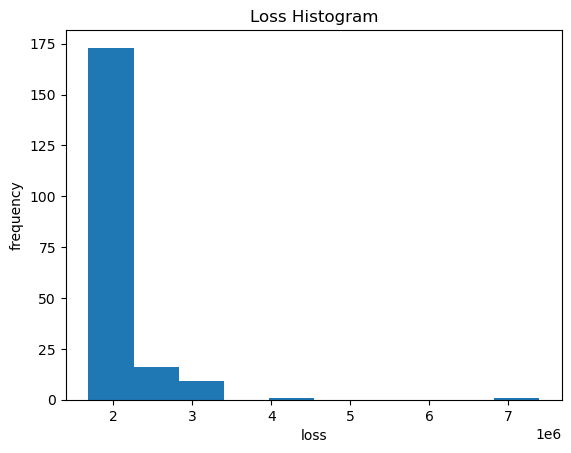

avg best error: 1684792.5728850719


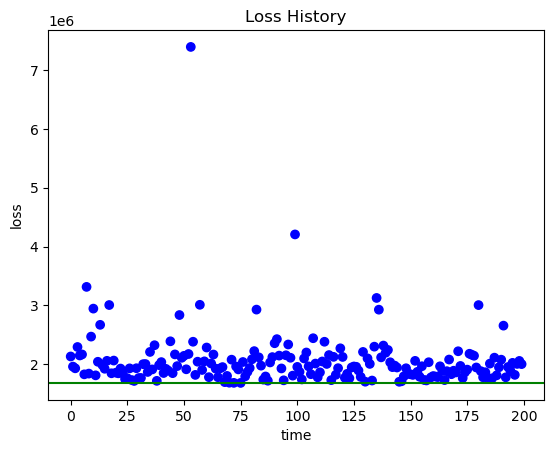

finite loss range 1684792.5728850719 7390968.128512718 1684791.5728850719


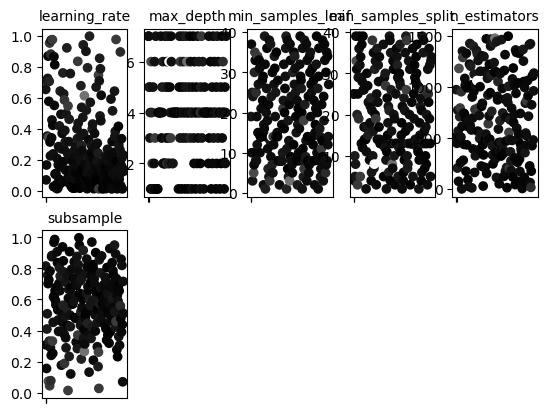

In [24]:
from hyperopt import plotting

# Plot a histogram of the hyperparameter distributions
plotting.main_plot_histogram(tpe_trials)

# Plot the history of the optimization process
plotting.main_plot_history(tpe_trials)

# Plot the values of the hyperparameters during optimization
plotting.main_plot_vars(tpe_trials)

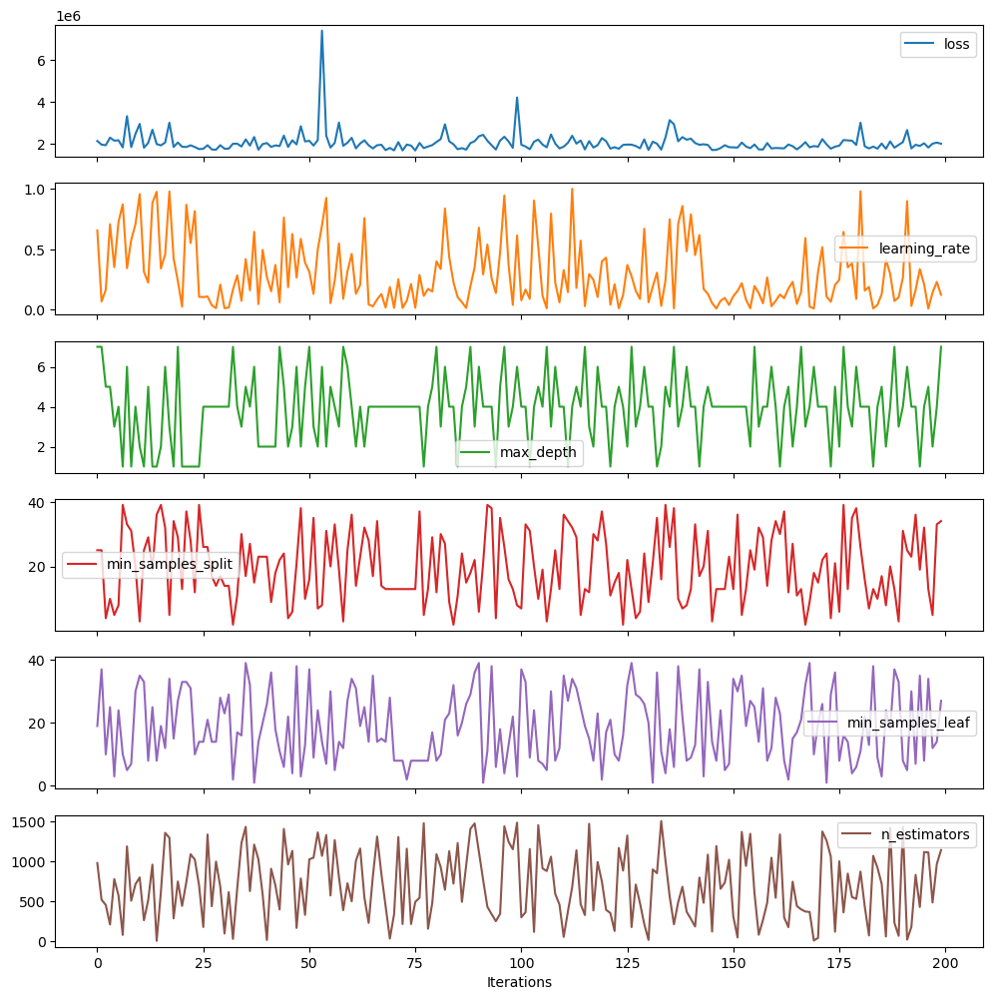

In [25]:
# Extract relevant information from tpe_trials and create a numpy array
plotting_data = np.array([
    [
        x["result"]["loss"],
        x["misc"]["vals"]["learning_rate"][0],
        x["misc"]["vals"]["max_depth"][0],
        x["misc"]["vals"]["min_samples_split"][0],
        x["misc"]["vals"]["min_samples_leaf"][0],
        x["misc"]["vals"]["n_estimators"][0],
    ] for x in tpe_trials.trials
])

# Create a DataFrame with the extracted data
plotting_data = pd.DataFrame(
    plotting_data,
    columns=["loss", "learning_rate", "max_depth", "min_samples_split", "min_samples_leaf", "n_estimators"]
)

# Plot subplots for each column in the DataFrame
plotting_data.plot(subplots=True, figsize=(12, 12))

# Set the x-axis label
plt.xlabel("Iterations")

# Display the plot
plt.show()

In [26]:
# Create a pipeline with preprocessors and a GradientBoostingRegressor using the best hyperparameters
model = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**best, random_state=42))
])

# Fit the model on the training data
model.fit(X_train, y_train)

# Evaluate the model's performance on the test data
test_score = model.score(X_test, y_test)
print("Test score is:", test_score)

# Evaluate the model's performance on the training data
train_score = model.score(X_train, y_train)
print("Train score is:", train_score)


Test score is: 0.7022315235589961
Train score is: 0.80666479147034


In [27]:
params={'learning_rate': 0.03672777587771769, 
'max_depth':8, 
'min_samples_leaf': 8,
'min_samples_split': 5,
'n_estimators': 158,
'subsample': 0.7380649633417082}

pipe = Pipeline([('preprocessors', preprocessors),
                ('regressor',GradientBoostingRegressor(**best,random_state=42))])

pipe.fit(X_train, y_train)
print("Test score is : ", pipe.score(X_test, y_test))
print("Train score is : ",pipe.score(X_train, y_train))

Test score is :  0.7022315235589961
Train score is :  0.80666479147034


In [28]:
params={'max_depth': 5,
 'learning_rate': 0.025631529910137833,
 'n_estimators': 174,
 'subsample': 0.11718744262870644}
pipe = Pipeline([('preprocessors', preprocessors),
                ('regressor',GradientBoostingRegressor(**params,random_state=42))])

# Fit the model to the training data
pipe.fit(X_train, y_train)

# Evaluate the model's performance on the test and train sets
print("Test score is : ", pipe.score(X_test, y_test))
print("Train score is : ",pipe.score(X_train, y_train))

Test score is :  0.7114006766522294
Train score is :  0.7821312475664777


In [29]:
# Create a pipeline with the best hyperparameters obtained from the random search
pipe = Pipeline([('preprocessors', preprocessors),
                ('regressor',GradientBoostingRegressor(**best,random_state=42))])

# Evaluate the model's performance on the test and train sets
pipe.fit(X_train, y_train)

# Evaluate the model's performance on the test and train sets
print("Test score is : ", pipe.score(X_test, y_test))
print("Train score is : ",pipe.score(X_train, y_train))

Test score is :  0.7022315235589961
Train score is :  0.80666479147034


In [30]:
# Create a pipeline with preprocessors and a GradientBoostingRegressor
pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

# Define the shuffle split cross-validation
shuffle = ShuffleSplit(n_splits=5, test_size=0.2, random_state=42)

# Create trials object to track the optimization process
rand_trials = Trials()

# Perform random search for hyperparameter optimization
best_rand = fmin(
    objective,
    space=param_grid,
    algo=rand.suggest,
    max_evals=200,
    rstate=np.random.default_rng(42),
    trials=rand_trials
)

# Print the best hyperparameters found
print(best_rand)

100%|██████████████████████████████████████████████| 200/200 [10:33<00:00,  3.17s/trial, best loss: 1684586.6275465793]
{'learning_rate': 0.03920098377311381, 'max_depth': 3, 'min_samples_leaf': 13, 'min_samples_split': 26, 'n_estimators': 110, 'subsample': 0.9641829608942055}


Showing Histogram of 200 jobs


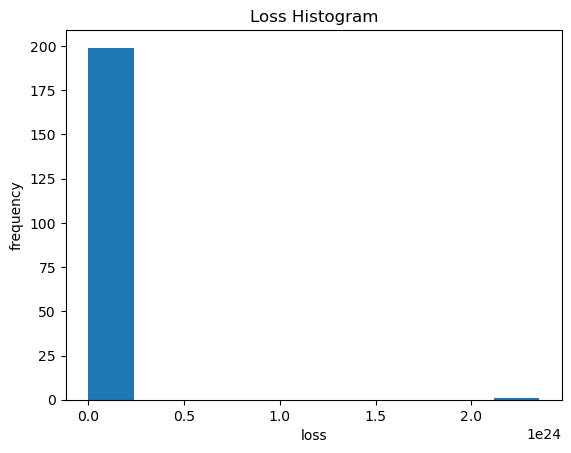

avg best error: 1684586.6275465793


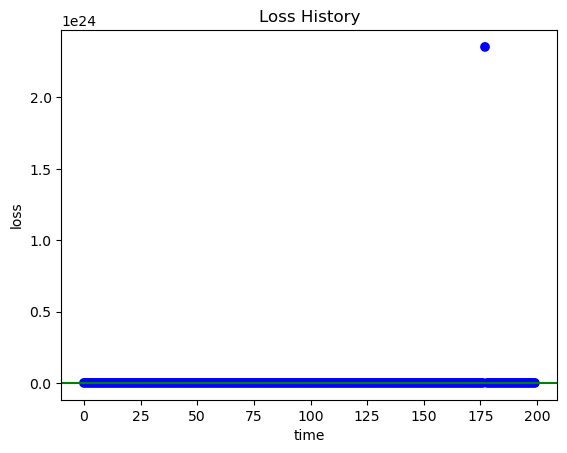

finite loss range 1684586.6275465793 2.3543632019788066e+24 1684585.6275465793


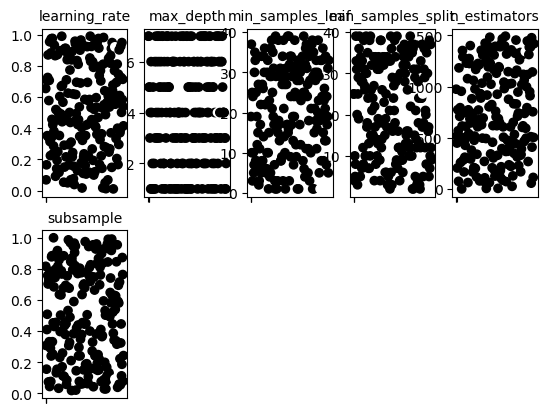

In [31]:
# Plot histogram of the random search trials
plotting.main_plot_histogram(rand_trials)

# Plot optimization history
plotting.main_plot_history(rand_trials)

# Plot variables during optimization
plotting.main_plot_vars(rand_trials)

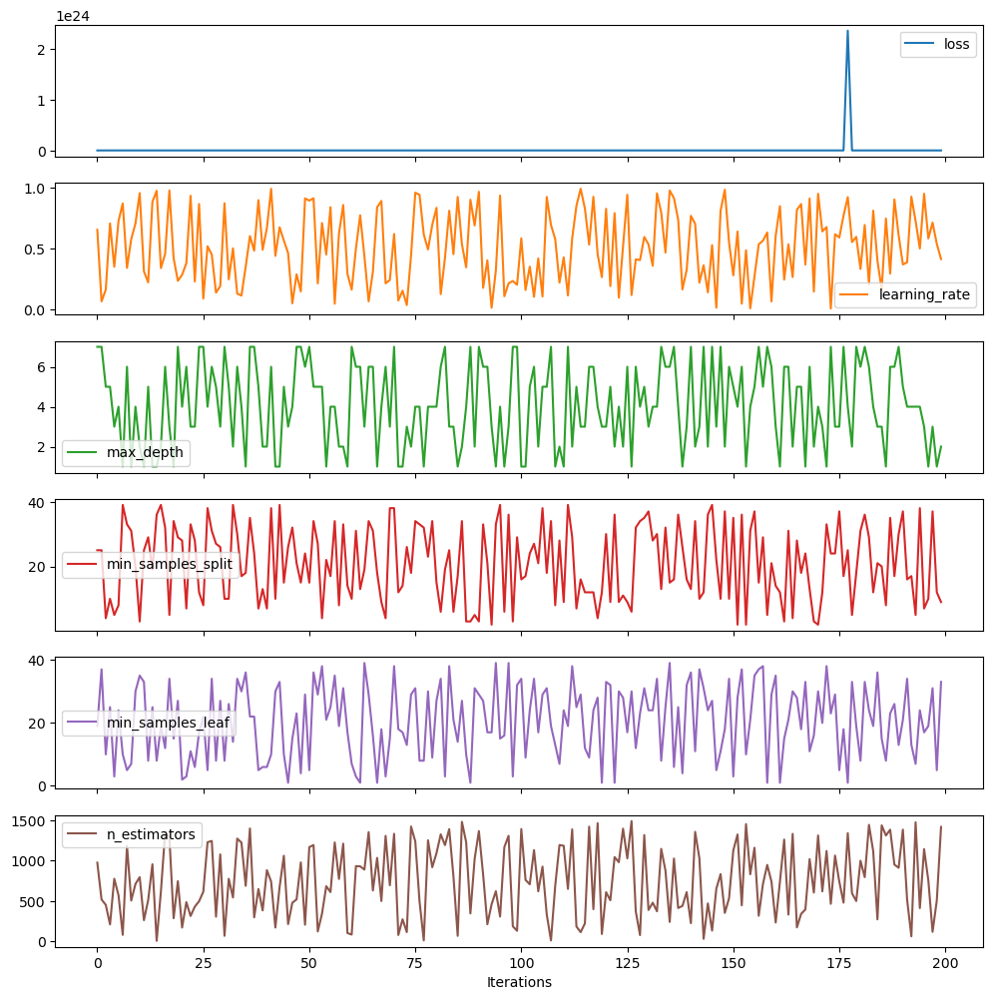

In [32]:
# Extract relevant data from the random search trials
plotting_data = np.array([
    [
        x["result"]["loss"],
        x["misc"]["vals"]["learning_rate"][0],
        x["misc"]["vals"]["max_depth"][0],
        x["misc"]["vals"]["min_samples_split"][0],
        x["misc"]["vals"]["min_samples_leaf"][0],
        x["misc"]["vals"]["n_estimators"][0],
    ] for x in rand_trials.trials
])

# Create a DataFrame from the extracted data
plotting_data = pd.DataFrame(
    plotting_data,
    columns=["loss", "learning_rate", "max_depth", "min_samples_split", "min_samples_leaf", "n_estimators"]
)

# Plot subplots of hyperparameters and their values over iterations
plotting_data.plot(subplots=True, figsize=(12, 12))
plt.xlabel("Iterations")
plt.show()

In [33]:
# Create a pipeline with the best hyperparameters obtained from the random search
model = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**best_rand, random_state=42))
])

# Fit the model to the training data
model.fit(X_train, y_train)

# Evaluate the model's performance on the test and train sets
print("Test score is:", model.score(X_test, y_test))
print("Train score is:", model.score(X_train, y_train))

Test score is: 0.6826081449014723
Train score is: 0.7470863526814626


In [34]:
# Create a pipeline with the preprocessors and GradientBoostingRegressor
pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

# Define the ShuffleSplit for cross-validation
shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)

# Create Trials object to store the results
atpe_trials = Trials()

# Perform hyperparameter optimization using Augmented TPE
atpe_best = fmin(
    objective,
    space=param_grid,
    algo=atpe.suggest,
    max_evals=200,
    rstate=np.random.default_rng(42),
    trials=atpe_trials
)

# Print the best hyperparameters obtained
print(atpe_best)

100%|███████████████████████████████████████████████| 200/200 [12:19<00:00,  3.70s/trial, best loss: 1667449.611285241]
{'learning_rate': 0.011843588831149124, 'max_depth': 2, 'min_samples_leaf': 8, 'min_samples_split': 28, 'n_estimators': 1408, 'subsample': 0.7774004855260861}


Showing Histogram of 200 jobs


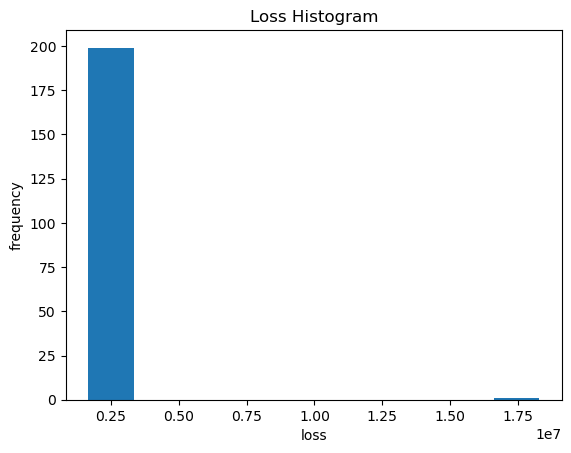

avg best error: 1667449.611285241


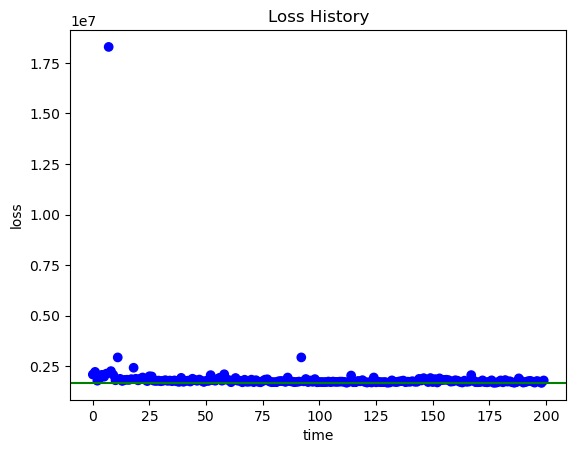

In [35]:
# Generate a histogram plot of the trials
plotting.main_plot_histogram(atpe_trials)

# Generate a history plot of the trials
plotting.main_plot_history(atpe_trials)


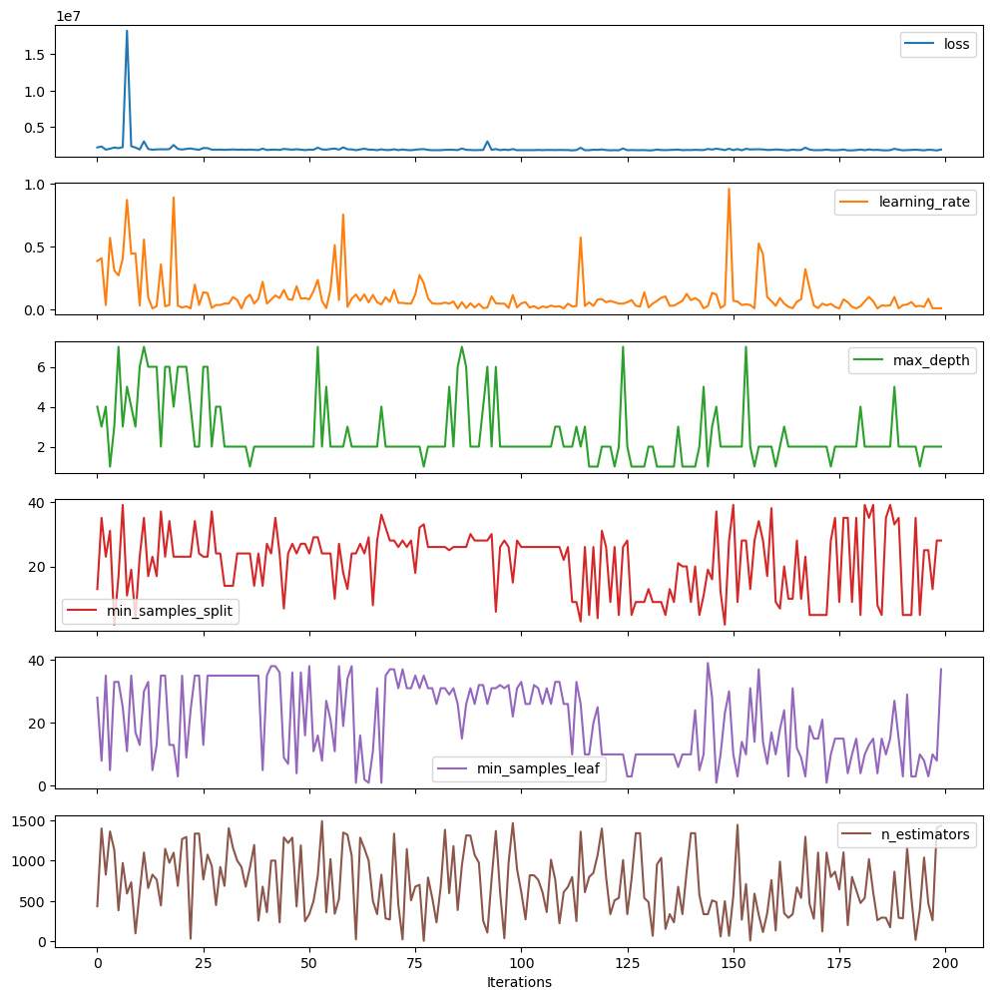

In [36]:
# Extract relevant information from the trials and create a numpy array
plotting_data = np.array([[x["result"]["loss"],
                           x["misc"]["vals"]["learning_rate"][0],
                           x["misc"]["vals"]["max_depth"][0],
                           x["misc"]["vals"]["min_samples_split"][0],
                           x["misc"]["vals"]["min_samples_leaf"][0],
                           x["misc"]["vals"]["n_estimators"][0],
                           ] for x in atpe_trials.trials])

# Create a DataFrame from the numpy array with appropriate column names
plotting_data = pd.DataFrame(plotting_data,
                             columns=["loss", "learning_rate", "max_depth", "min_samples_split",
                                      "min_samples_leaf", "n_estimators"])

# Plot the DataFrame as subplots
plotting_data.plot(subplots=True, figsize=(12, 12))
plt.xlabel("Iterations")
plt.show()

In [37]:
# Create the pipeline with preprocessors and the regressor
model = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**atpe_best, random_state=42))
])

# Fit the model on the training data
model.fit(X_train, y_train)

# Evaluate the model on the test and train data
print("Test score is: ", model.score(X_test, y_test))
print("Train score is: ", model.score(X_train, y_train))

Test score is:  0.6945966855744501
Train score is:  0.7801370303437917


In [38]:
# Create a pipeline with the preprocessors and GradientBoostingRegressor
pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

# Define the ShuffleSplit and KFold for cross-validation
shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# Create Trials object to store the results
anneal_trials = Trials()

# Perform hyperparameter optimization using Annealing
anneal_best = fmin(
    objective,
    space=param_grid,
    algo=anneal.suggest,
    max_evals=200,
    rstate=np.random.default_rng(42),
    trials=anneal_trials
)

# Print the best hyperparameters obtained
print(anneal_best)

100%|██████████████████████████████████████████████| 200/200 [03:14<00:00,  1.03trial/s, best loss: 1756255.5124823663]
{'learning_rate': 0.748443711470068, 'max_depth': 1, 'min_samples_leaf': 19, 'min_samples_split': 31, 'n_estimators': 94, 'subsample': 0.9832572581653855}


Showing Histogram of 200 jobs


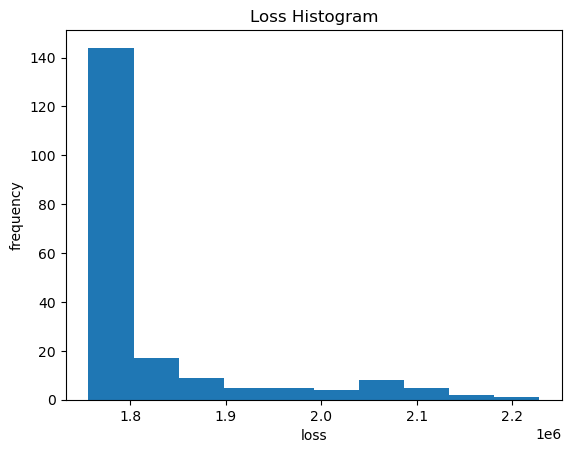

avg best error: 1756255.5124823663


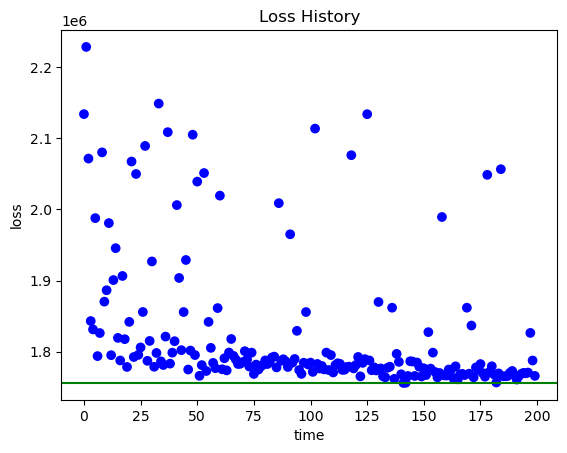

finite loss range 1756255.5124823663 2228330.5017715474 1756254.5124823663


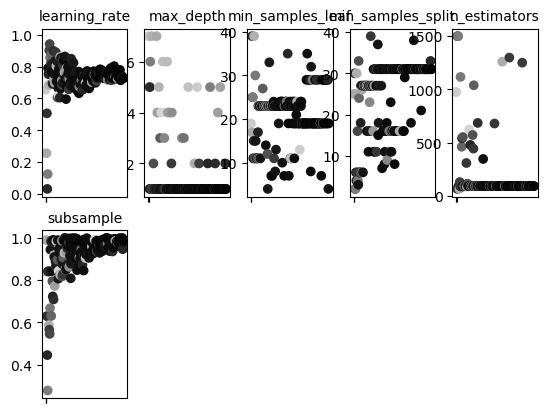

In [39]:
# Plot histogram
plotting.main_plot_histogram(anneal_trials)

# Plot history
plotting.main_plot_history(anneal_trials)

# Plot variables
plotting.main_plot_vars(anneal_trials)

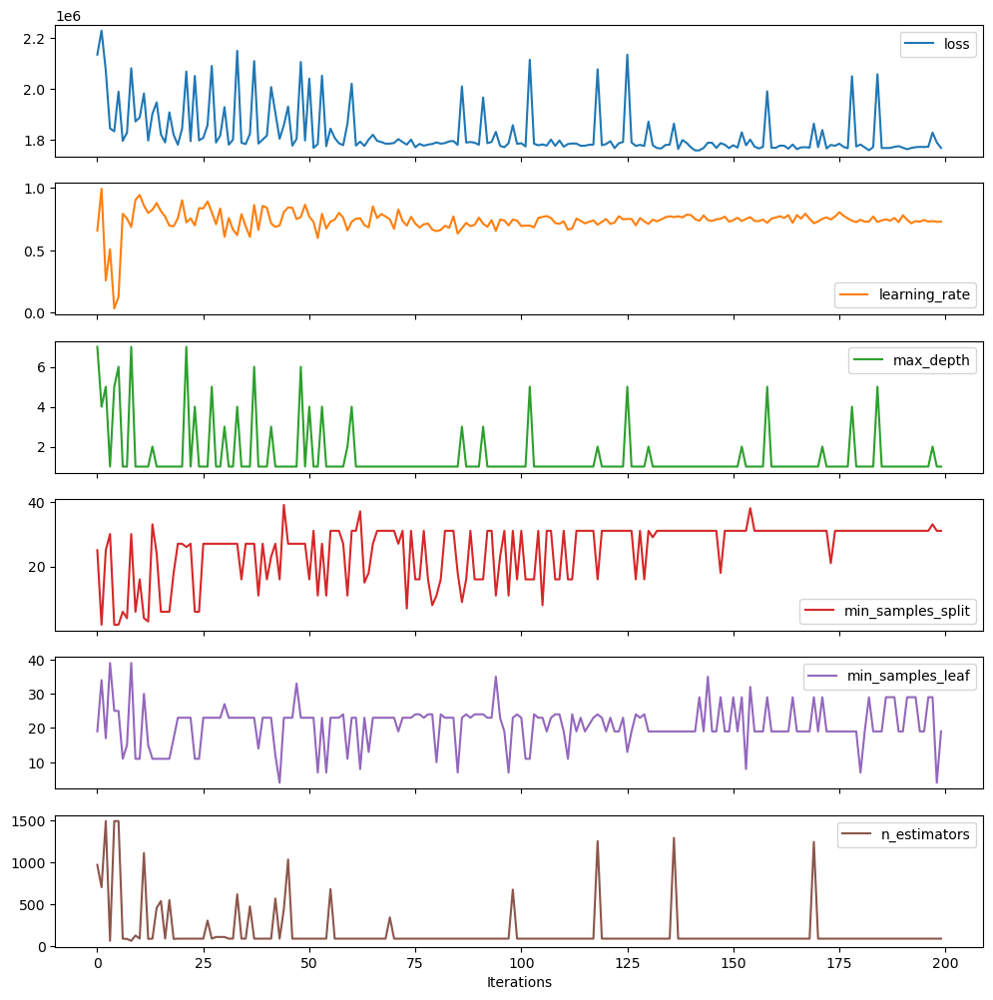

In [40]:
# Extract the relevant data from anneal_trials and create a numpy array
plotting_data = np.array([
    [
        x["result"]["loss"],
        x["misc"]["vals"]["learning_rate"][0],
        x["misc"]["vals"]["max_depth"][0],
        x["misc"]["vals"]["min_samples_split"][0],
        x["misc"]["vals"]["min_samples_leaf"][0],
        x["misc"]["vals"]["n_estimators"][0],
    ] for x in anneal_trials.trials
])

# Create a DataFrame using the plotting_data array and assign column names
plotting_data = pd.DataFrame(
    plotting_data,
    columns=["loss", "learning_rate", "max_depth", "min_samples_split", "min_samples_leaf", "n_estimators"]
)

# Plot the subplots using the DataFrame
plotting_data.plot(subplots=True, figsize=(12, 12))
plt.xlabel("Iterations")
plt.show()

In [41]:
# Create a pipeline with preprocessors and a GradientBoostingRegressor
model = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**anneal_best, random_state=42))
])

# Fit the pipeline on the training data
model.fit(X_train, y_train)

# Evaluate the model's performance on the test and train datasets
print("Test score is:", model.score(X_test, y_test))
print("Train score is:", model.score(X_train, y_train))


Test score is: 0.6431496607316708
Train score is: 0.7172272840198157


<a id="fp"></a>
## <span style="color:#33afff  ;"> Gradient Boosting Regression  Optimization With Optuna</span>

In [42]:
def objective(trial):
    """
    Objective function for Optuna hyperparameter optimization.
    
    Args:
        trial (optuna.Trial): A trial object that stores the hyperparameters to be evaluated.
        
    Returns:
        float: Mean R^2 score obtained by performing cross-validation.
    """
    # Define the hyperparameters to be tuned
    n_estimators = trial.suggest_int("n_estimators", 100, 2000)
    learning_rate = trial.suggest_float('learning_rate', 0.01, 1)
    subsample = trial.suggest_float('subsample', 0.1, 1)
    max_depth = trial.suggest_int('max_depth', 1, 10)
    min_samples_split = trial.suggest_int("min_samples_split", 2, 50)
    min_samples_leaf = trial.suggest_int("min_samples_leaf", 1, 50)
    loss = trial.suggest_categorical('loss', ['absolute_error', 'squared_error', 'huber', 'quantile'])
    
    # Update the regressor parameters based on the trial suggestions
    gradient_pipe.set_params(
        regressor__n_estimators=n_estimators,
        regressor__learning_rate=learning_rate,
        regressor__subsample=subsample,
        regressor__max_depth=max_depth,
        regressor__min_samples_split=min_samples_split,
        regressor__min_samples_leaf=min_samples_leaf,
        regressor__loss=loss
    )
    
    # Perform cross-validation and return the mean R^2 score
    return cross_val_score(gradient_pipe, X_train, y_train, n_jobs=-1, cv=kf, scoring='r2').mean()

In [43]:
# Create the pipeline with preprocessors and the regressor
gradient_pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Create an Optuna study object
study_gbr = optuna.create_study(direction='maximize')

# Run the optimization process using the objective function for a maximum of 200 trials
study_gbr.optimize(objective, n_trials=200)

[I 2023-05-13 06:04:41,937] A new study created in memory with name: no-name-3944aded-753f-4867-968a-5ab1ad859fa7
[I 2023-05-13 06:04:43,389] Trial 0 finished with value: -0.3553403249787571 and parameters: {'n_estimators': 806, 'learning_rate': 0.9448250807008777, 'subsample': 0.3348339211530266, 'max_depth': 1, 'min_samples_split': 42, 'min_samples_leaf': 44, 'loss': 'quantile'}. Best is trial 0 with value: -0.3553403249787571.
[I 2023-05-13 06:04:44,745] Trial 1 finished with value: 0.5065407135367548 and parameters: {'n_estimators': 398, 'learning_rate': 0.9903168025046373, 'subsample': 0.8181012176046332, 'max_depth': 2, 'min_samples_split': 8, 'min_samples_leaf': 48, 'loss': 'huber'}. Best is trial 1 with value: 0.5065407135367548.
[I 2023-05-13 06:04:48,166] Trial 2 finished with value: 0.3651325810039219 and parameters: {'n_estimators': 1365, 'learning_rate': 0.723575495244454, 'subsample': 0.1624756964543764, 'max_depth': 5, 'min_samples_split': 8, 'min_samples_leaf': 39, 'los

In [44]:
trial_gbr = study_gbr.best_trial
trial_gbr.params

{'n_estimators': 156,
 'learning_rate': 0.028553578833266684,
 'subsample': 0.622943570067479,
 'max_depth': 5,
 'min_samples_split': 25,
 'min_samples_leaf': 7,
 'loss': 'huber'}

In [45]:
# Create the pipeline with preprocessors and the regressor using the best hyperparameters
gradient_pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**trial_gbr.params, random_state=42))
])

# Fit the pipeline on the training data
gradient_pipe.fit(X_train, y_train)

# Evaluate the pipeline on the test data
score = gradient_pipe.score(X_test, y_test)
score

0.6982186699389045

In [46]:
# Create a pipeline with preprocessors and a GradientBoostingRegressor
gradient_pipe = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**trial_gbr.params, random_state=42))
])

# Fit the pipeline on the training data
gradient_pipe.fit(X_train, y_train)

# Calculate the R^2 score on the test data
score = gradient_pipe.score(X_test, y_test)
score

0.6982186699389045

In [47]:
gradient_pipe.score(X_train, y_train)

0.7846853355152881

In [48]:
trial_gbr = study_gbr.best_trial
print('Root Mean Squared Error: {}'.format(trial_gbr.value))
print("Best Hyperparameters: {}".format(trial_gbr.params))

Root Mean Squared Error: 0.6658128003685457
Best Hyperparameters: {'n_estimators': 156, 'learning_rate': 0.028553578833266684, 'subsample': 0.622943570067479, 'max_depth': 5, 'min_samples_split': 25, 'min_samples_leaf': 7, 'loss': 'huber'}


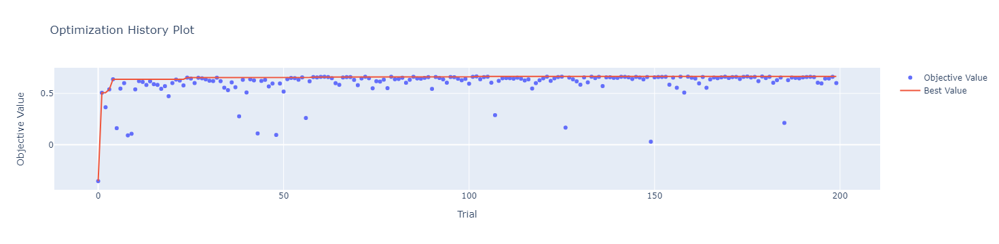

In [49]:
optuna.visualization.plot_optimization_history(study_gbr)

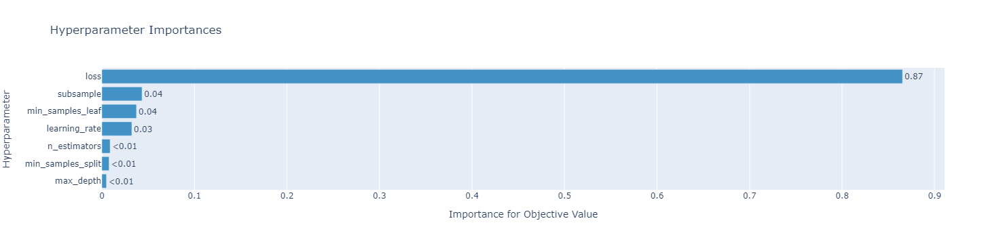

In [50]:
optuna.visualization.plot_param_importances(study_gbr)

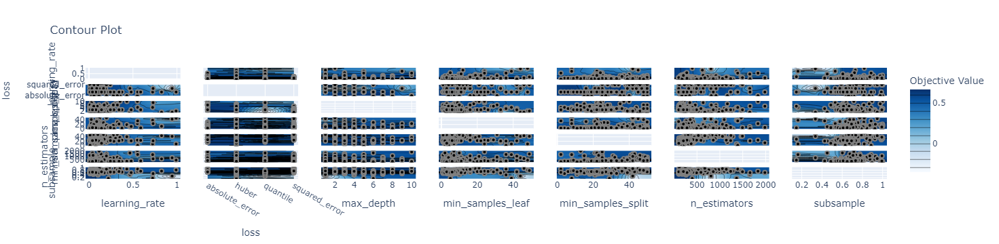

In [51]:
optuna.visualization.plot_contour(study_gbr)

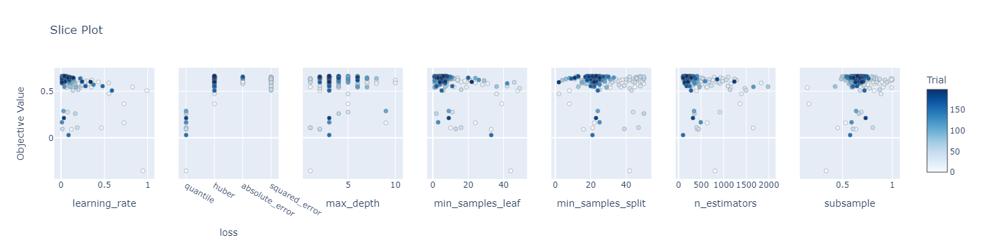

In [52]:
optuna.visualization.plot_slice(study_gbr)

<a id="fp"></a>
## <span style="color:#33afff  ;"> Gradient Boosting Regression  Features Importances</span>

max_depth: 2
learning_rate: 0.01
n_estimators: 
subsample: 0.7

In [53]:
# Create an instance of GradientBoostingRegressor with specific hyperparameters
gradient_regression = GradientBoostingRegressor(learning_rate=0.01, max_depth=2, n_estimators=1027, random_state=42, subsample=0.7)

# Fit the model on the transformed training data
gradient_regression.fit(X_train_trans, y_train)

# Evaluate the model on the transformed test data
test_score = gradient_regression.score(X_test_trans, y_test)
train_score = gradient_regression.score(X_train_trans, y_train)

# Print the test score and train score
print("Test score is:", test_score)
print("Train score is:", train_score)

Test score is: 0.71692168537952
Train score is: 0.7753161092936065


In [54]:
features= X_test_trans.columns.values.tolist()

# Create LimeTabularExplainer object
explainer = lime_tabular.LimeTabularExplainer(X_train_trans.values, mode="regression", feature_names= X_train_trans.columns.values.tolist(),
                                                 class_names=['SiteEnergyUseWN(kBtu)'], verbose=True,)
explainer

In [55]:
j =  np.random.randint(1, len(X_test))
print("j=", j)
exp = explainer.explain_instance(X_test_trans.values[j], gradient_regression.predict, num_features=len(features))

j= 39
Intercept 6376205.0440671425
Prediction_local [3105536.92200787]
Right: 3115892.9431901197


- j= 82
- Intercept 5755835.297570122
- Prediction_local [1618088.04430028]
- Right: 1528686.6778334337

In [56]:
exp.show_in_notebook(show_table=True)

In [57]:
def explanation_point(model, features: List[str], X_test: pd.DataFrame, Y_test: pd.DataFrame, idx: int = np.random.randint(1, len(X_test))) -> Tuple[lime_tabular.Explanation, List[Tuple[str, float]], Dict[int, float]]:
    """
    Generates an explanation for an individual prediction using LimeTabularExplainer.

    Args:
        model: The trained model.
        features: List of feature names.
        X_test: Test data for which the prediction is explained.
        Y_test: Ground truth labels for test data.
        idx: Index of the instance in the test data to explain (default: randomly selected).

    Returns:
        Tuple containing the Lime explanation object, list of feature importance tuples, and the feature importance map.

    """
    # Create LimeTabularExplainer object
    explainer = LimeTabularExplainer(X_train_trans.values, mode="regression", feature_names=X_train_trans.columns.values.tolist(),
                                     class_names=['SiteEnergyUseWN(kBtu)'], verbose=True)
    
    explanation = explainer.explain_instance(X_test.values[idx], model.predict, num_features=len(features))
    print("test index:", idx)
    print("Explanation Local Prediction  : ", explanation.local_pred)
    print("Explanation Global Prediction : ", explanation.predicted_value)
    explanation.show_in_notebook()
    
    with plt.style.context("ggplot"):
        explanation.as_pyplot_figure()
    explanation.as_list()
    explanation.save_to_file("gradient_explanation.html")
    
    return explanation, explanation.as_list(), explanation.as_map()

Intercept 4938726.333809385
Prediction_local [7134737.8597165]
Right: 4812673.443659975
test index: 234
Explanation Local Prediction  :  [7134737.8597165]
Explanation Global Prediction :  4812673.443659975


(<lime.explanation.Explanation at 0x1fbd408f610>,
 [('PropertyGFATotal > 0.04', 4712978.87161176),
  ('LargestPropertyUseType_Self-Storage Facility <= 0.00', 1088621.9025539802),
  ('LargestPropertyUseType_Senior Care Community <= 0.00', -998067.2566197292),
  ('LargestPropertyUseType_Finance <= 0.00', -837276.2230506404),
  ('LargestPropertyUseType_Distribution Center/ Warehouse <= 0.00',
   824057.7383175404),
  ('BuildingType_Nonresidential COS-WA <= 0.00', -636627.2158583137),
  ('LargestPropertyUseType_Care <= 0.00', -622935.5752232074),
  ('LargestPropertyUseType_RetailStore/Culture/Other <= 0.00',
   -423124.04824638536),
  ('MainEnergy_Steam <= 0.00', -386066.06149875897),
  ('LargestPropertyUseType_Supermarket/Grocery Store <= 0.00',
   -329433.47505751654),
  ('LargestPropertyUseType_Lodge/RefrigeratedWarahouse <= 0.00',
   -285540.67726394144),
  ('LargestPropertyUseType_Medical Office <= 0.00', 283828.3738419058),
  ('LargestPropertyUseType_Restaurant <= 0.00', -255328.7778

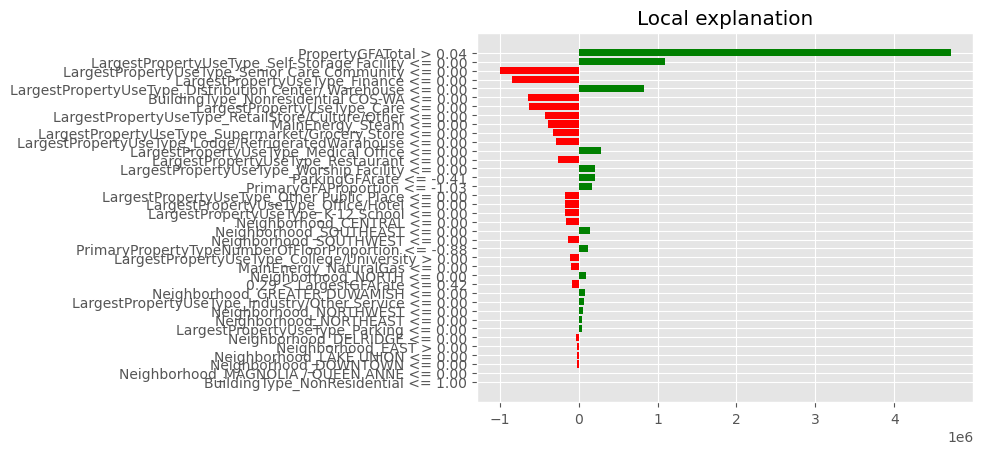

In [58]:
explanation_point(gradient_regression, features, X_test_trans, y_test_trans)

In [59]:
shap.initjs()
grad_explainer = shap.TreeExplainer(gradient_regression, X_train_trans, feature_names=features)
grad_explainer

In [60]:
def shape_explainer(model: Any, features: List[str], X_train: pd.DataFrame, X_test: pd.DataFrame, 
                   Y_test: pd.Series, idx: int = np.random.randint(1, len(X_test)), max_display: int = 10) -> None:
    """
    Generate SHAP explanation plots for a given model and features using the SHAP library.

    Args:
        model (Any): The trained model object.
        features (List[str]): List of feature names.
        X_train (pd.DataFrame): Training dataset.
        X_test (pd.DataFrame): Test dataset.
        Y_test (pd.Series): True target values for the test dataset.
        idx (int, optional): Index of the test sample to explain. Defaults to a random index.
        max_display (int, optional): Maximum number of features to display in waterfall plot. Defaults to 10.

    Returns:
        None: Displays the SHAP explanation plots.

    """
    
    print("Test index:", idx)
    
    # Create a SHAP TreeExplainer for the given model and training data
    explainer = shap.TreeExplainer(model, X_train, feature_names=features)
    
    print("Shap bar plot")
    # Generate and display a SHAP bar plot
    shap.bar_plot(explainer.shap_values(X_test.iloc[0]), feature_names=features)
    
    print("Waterfall plot")
    # Generate and display a SHAP waterfall plot
    shap_values = explainer(X_test[:idx])
    shap_values.feature_names = features
    shap.waterfall_plot(shap_values[0], max_display=max_display)
    
    print("Decision plot")
    # Generate and display a SHAP decision plot
    shap.decision_plot(explainer.expected_value, explainer.shap_values(X_test.iloc[idx]), feature_names=features)
    
    print("Decision plot for multiple samples")
    # Generate and display a SHAP decision plot for multiple samples
    shap.decision_plot(explainer.expected_value, explainer.shap_values(X_test[0:5]), feature_names=features, 
                       highlight=[1, 2])
    
    print("Force plot")
    # Generate and display a SHAP force plot for a single sample
    shap.force_plot(explainer.expected_value, explainer.shap_values(X_test.iloc[idx]), feature_names=features, 
                    out_names="Energy consumption")
    
    # Generate and display a SHAP force plot for multiple samples
    shap.force_plot(explainer.expected_value, explainer.shap_values(X_test[0:10]), feature_names=features, 
                    out_names="Energy consumption", figsize=(25, 3), link="identity")
    
    print("Summary plot")
    # Generate and display a SHAP summary plot (bar plot)
    shap.summary_plot(explainer.shap_values(X_test), feature_names=features, plot_type="bar", color="dodgerblue")
    
    # Generate and display a SHAP summary plot (violin plot)
    shap.summary_plot(explainer.shap_values(X_test), feature_names=features, plot_type="violin", color="tomato")

test index: 30
Shap bar plot


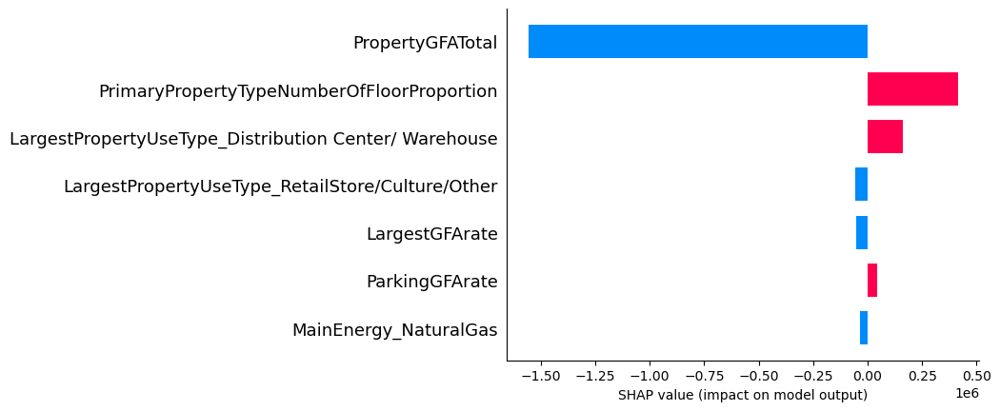

Waterfall plot


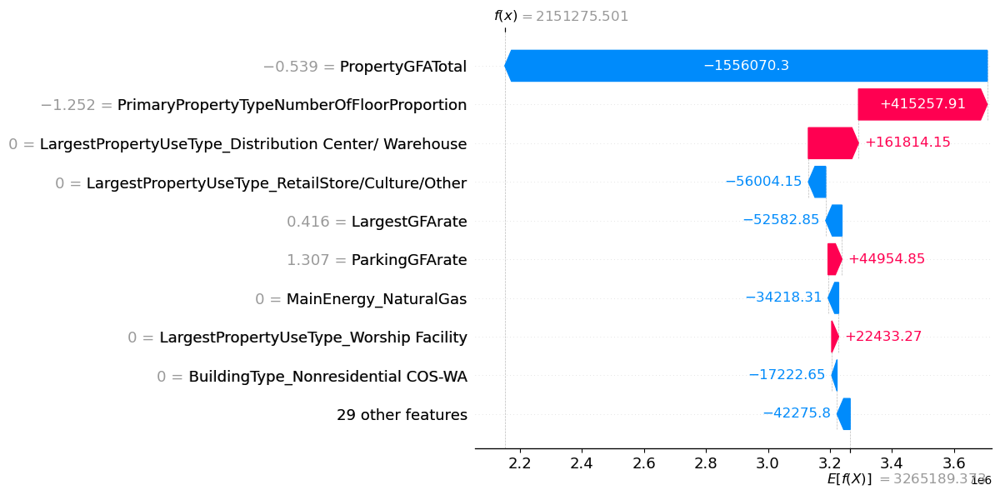

Decision plot


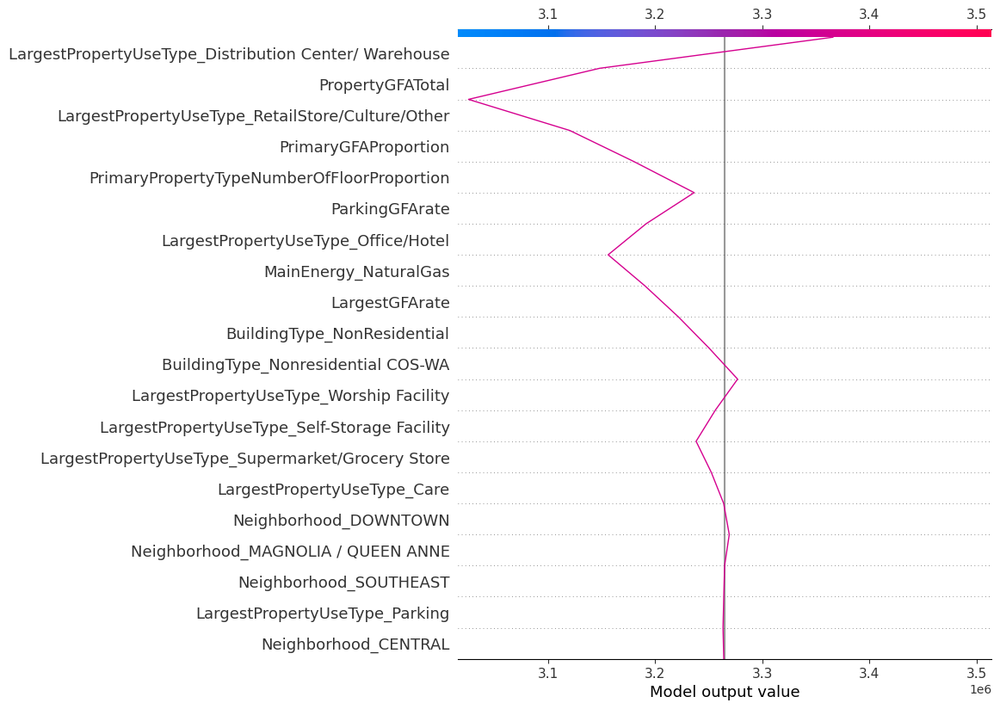

Decision plot for multiple sample


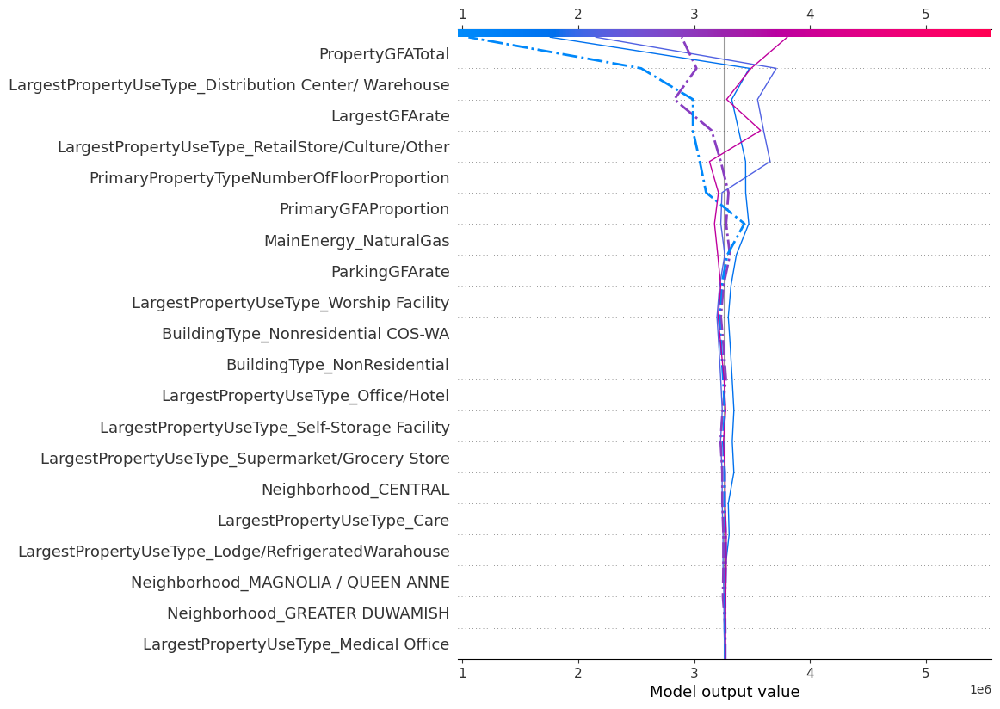

Force plot
Summary plot


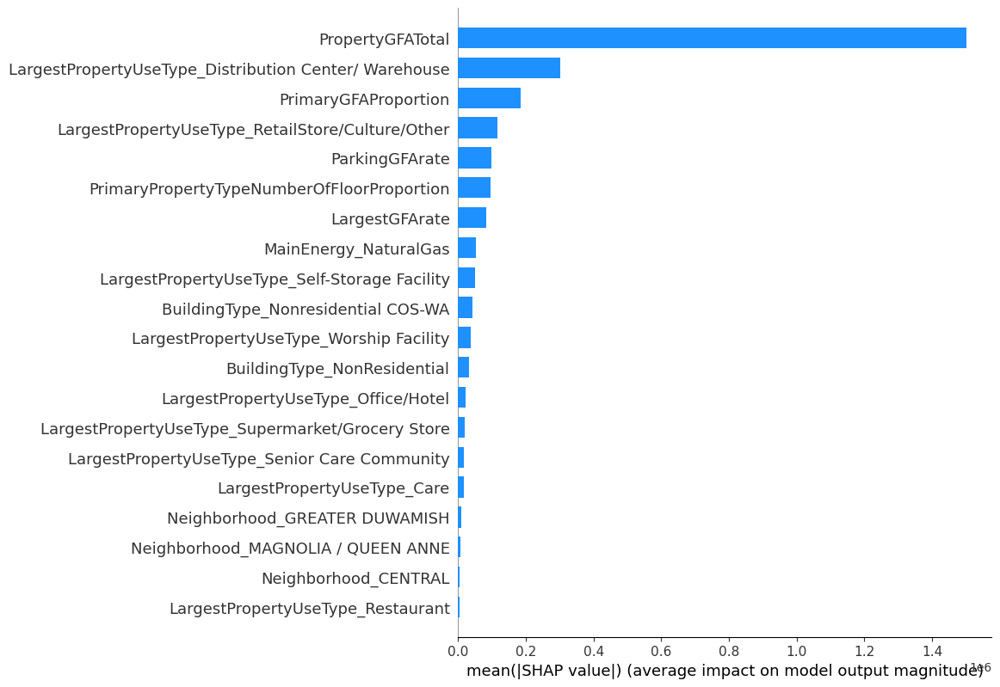

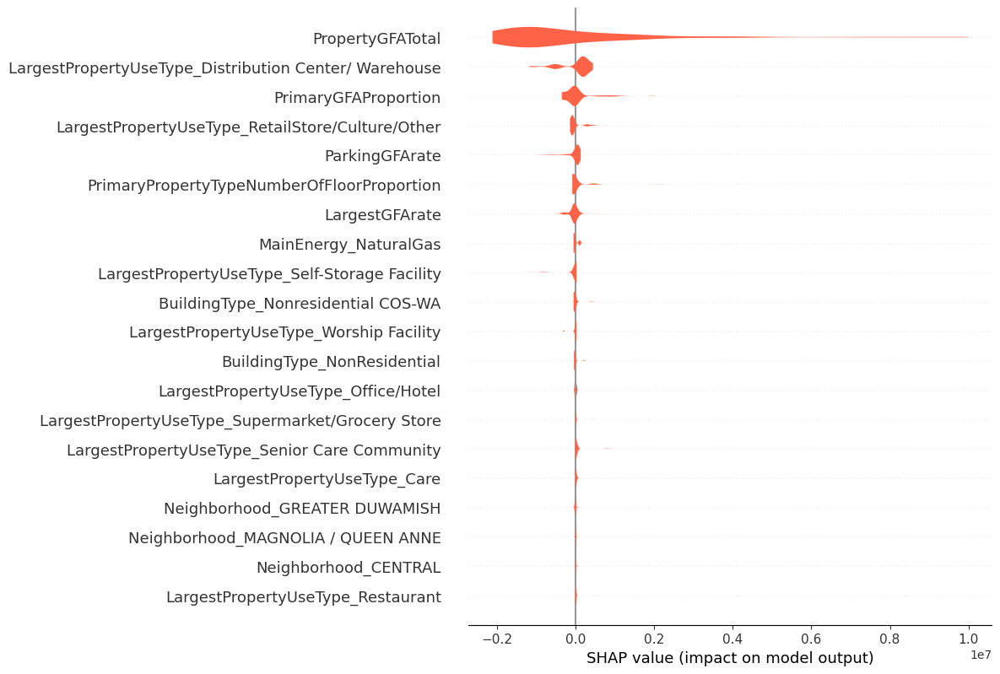

In [61]:
shape_explainer(gradient_regression, features,X_train_trans, X_test_trans, y_test_trans, idx = np.random.randint(1, len(X_test)),max_display=10)


In [62]:
shap.force_plot(grad_explainer.expected_value,
                grad_explainer.shap_values(X_test_trans.iloc[216]),
                feature_names=features,
                out_names="Energy consumption")

In [63]:
shap.force_plot(grad_explainer.expected_value,
                grad_explainer.shap_values(X_test_trans[0:10]),
                feature_names=features,
                out_names="Energy consumption", figsize=(25,3),
                link="identity")

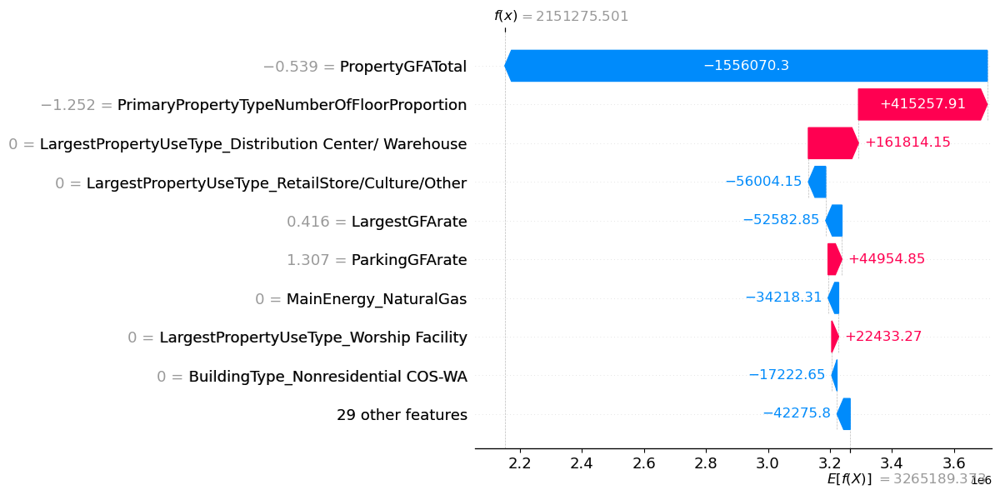

In [64]:
shap_values = grad_explainer(X_test_trans[:3])
shap_values.feature_names = features

shap.waterfall_plot(shap_values[0], max_display=10)

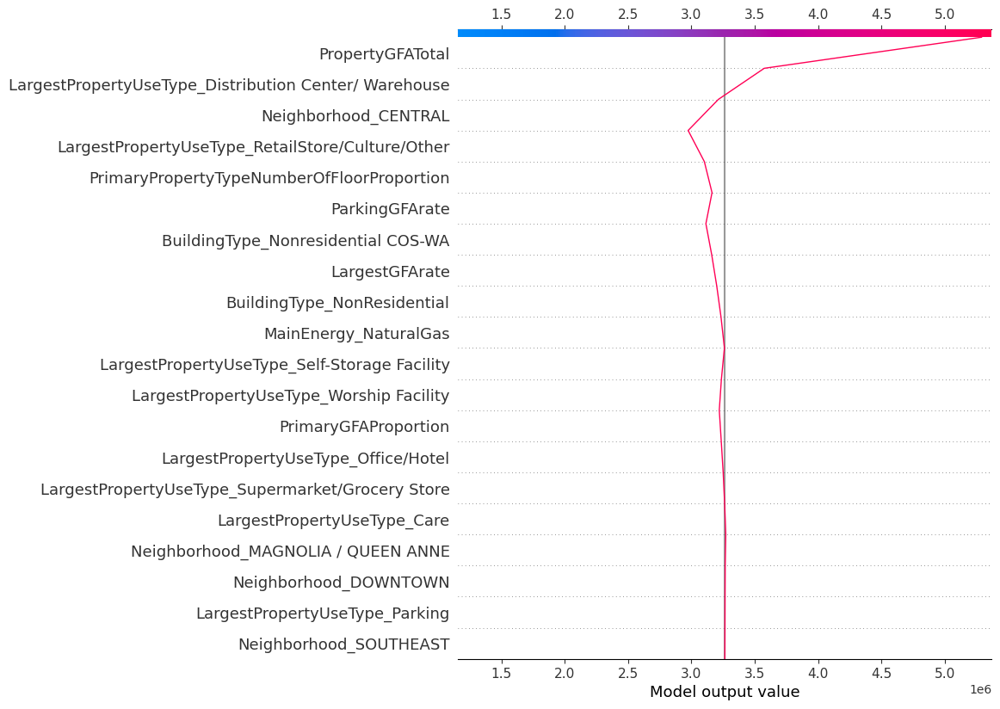

In [65]:
shap.decision_plot(grad_explainer.expected_value,
                   grad_explainer.shap_values(X_test_trans.iloc[35]),
                   feature_names=features,
                   )

In [66]:
def embedding_plot(model_explainer: Any, features: List[str], X_test: np.ndarray) -> None:
    """
    Generate embedding plots for the given features using the provided model explainer.

    Args:
        model_explainer (Any): The SHAP model explainer object with a shap_values method.
        features (List[str]): List of feature names for which embedding plots will be generated.
        X_test (np.ndarray): Test dataset used for generating embedding plots.

    Returns:
        None: Displays the embedding plots.

    """
    for feature in features:
        shap.embedding_plot(
            feature,
            model_explainer.shap_values(X_test),
            feature_names=features
        )


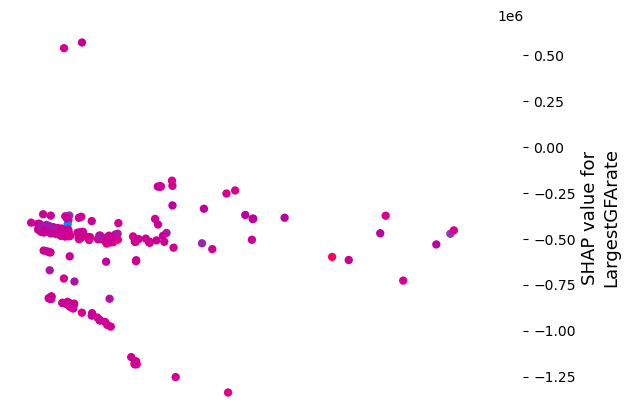

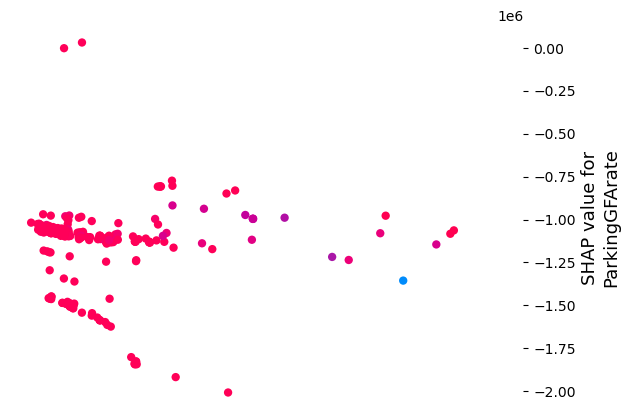

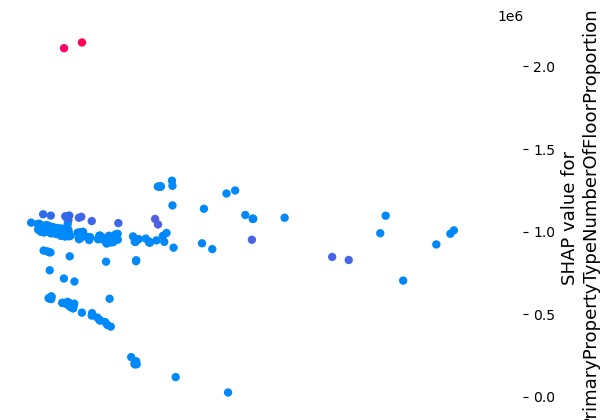

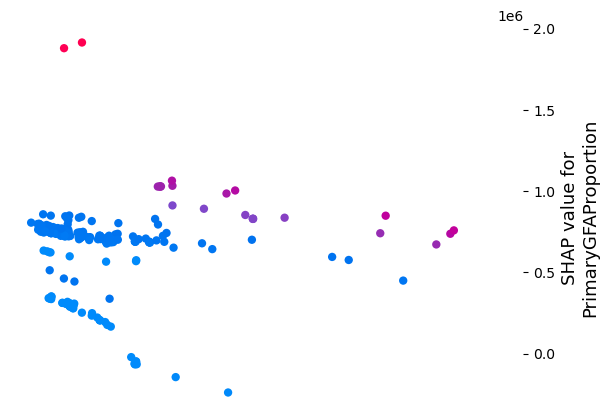

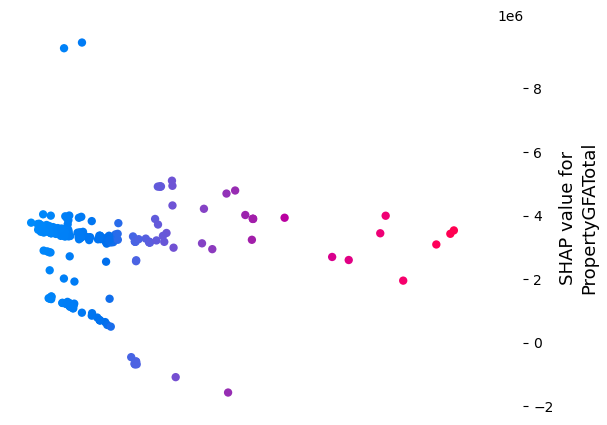

...

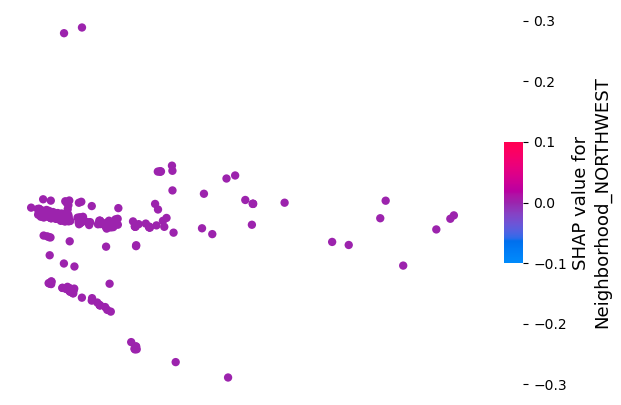

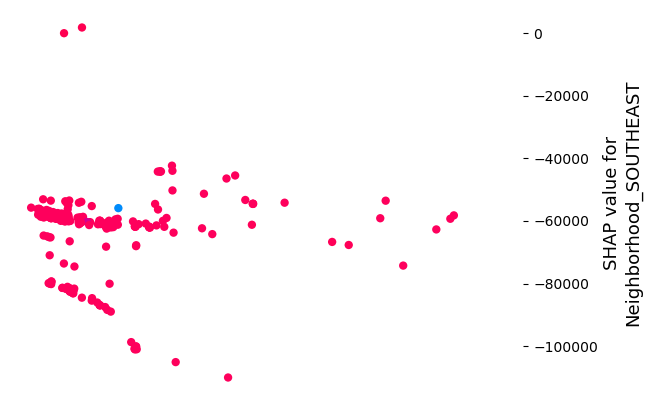

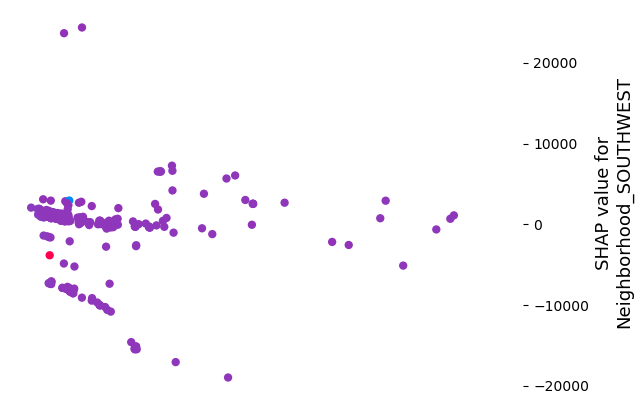

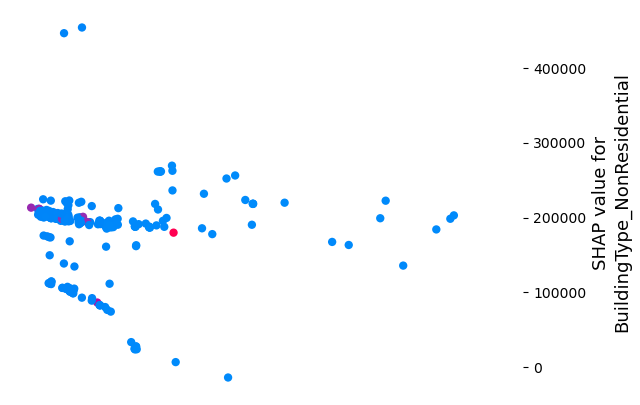

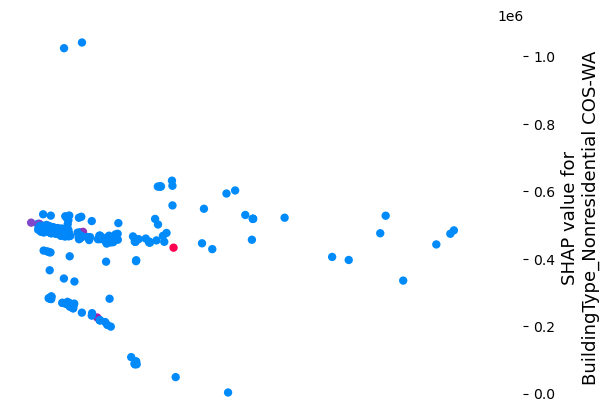

In [67]:
embedding_plot(grad_explainer, features, X_test_trans)

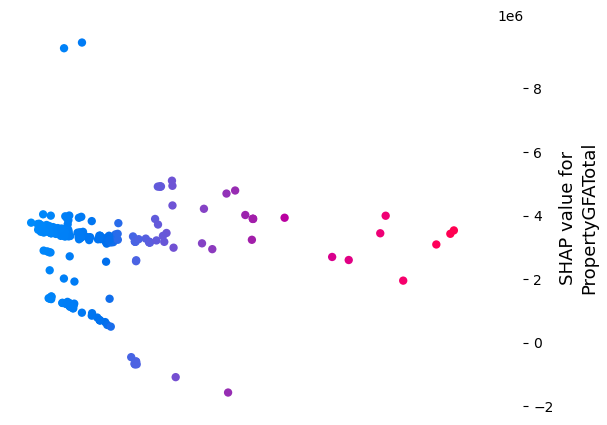

In [68]:
shap.embedding_plot("PropertyGFATotal",
                     grad_explainer.shap_values(X_test_trans),
                     feature_names=features,
                     )

In [69]:
def partial_dependence_plot(model: Any, features: List[str], X_train: np.ndarray) -> None:
    """
    Generate partial dependence plots for the given features using the provided model.

    Args:
        model (Any): The trained model object with a predict method.
        features (List[str]): List of feature names for which partial dependence plots will be generated.
        X_train (np.ndarray): Training dataset used for generating partial dependence plots.

    Returns:
        None: Displays the partial dependence plots.

    """
    for feature in features:
        shap.plots.partial_dependence(
            feature,
            model.predict,
            X_train,
            ice=False,
            model_expected_value=True,
            feature_expected_value=True
        )

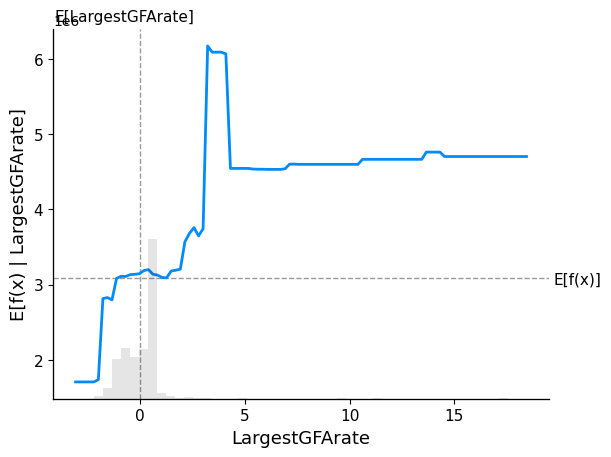

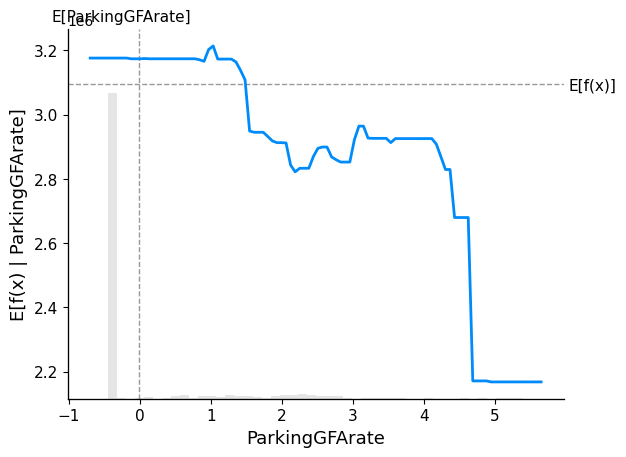

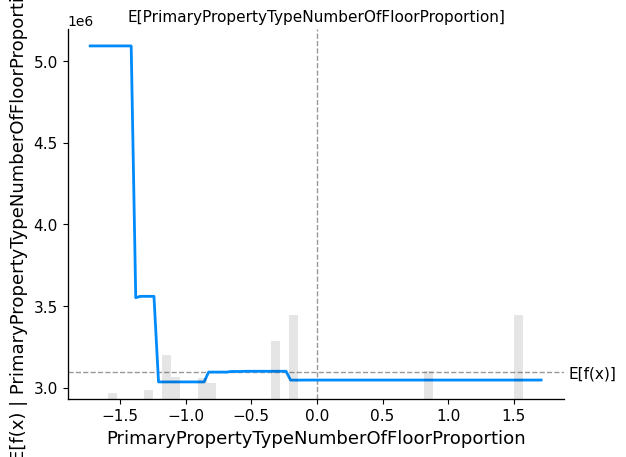

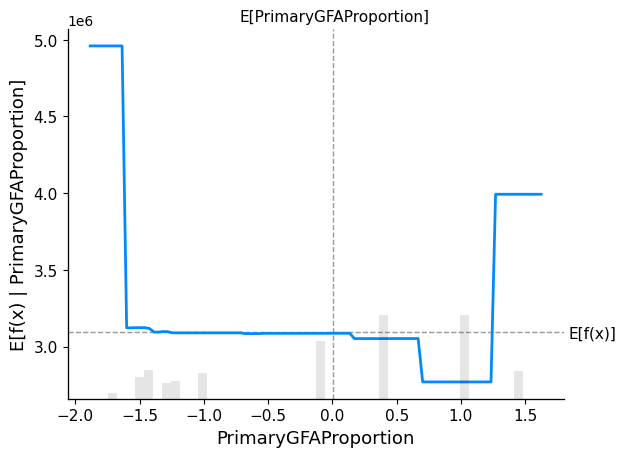

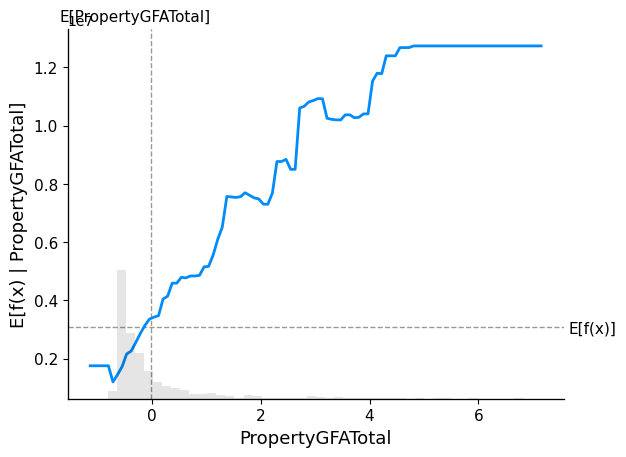

...

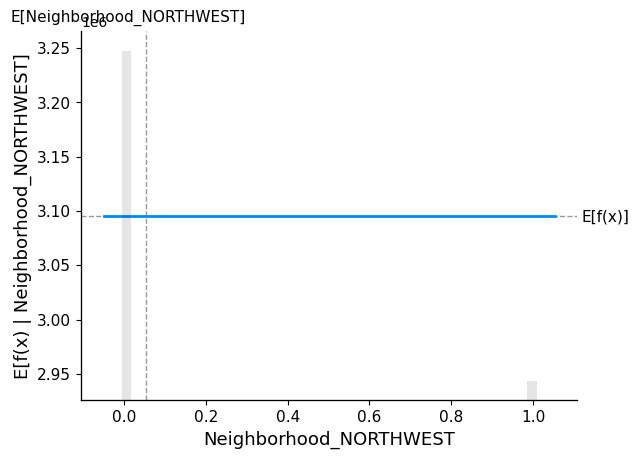

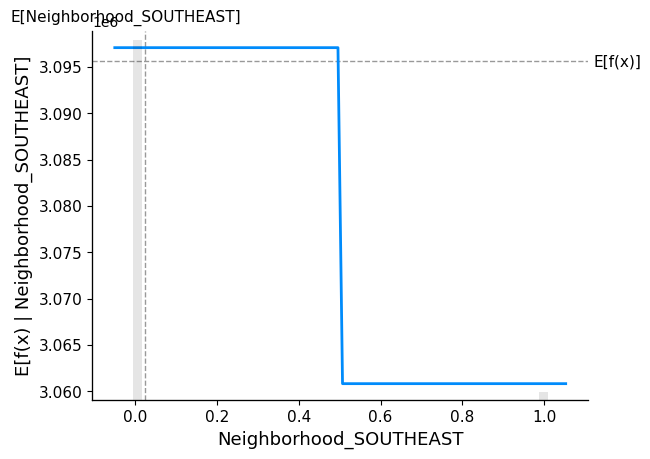

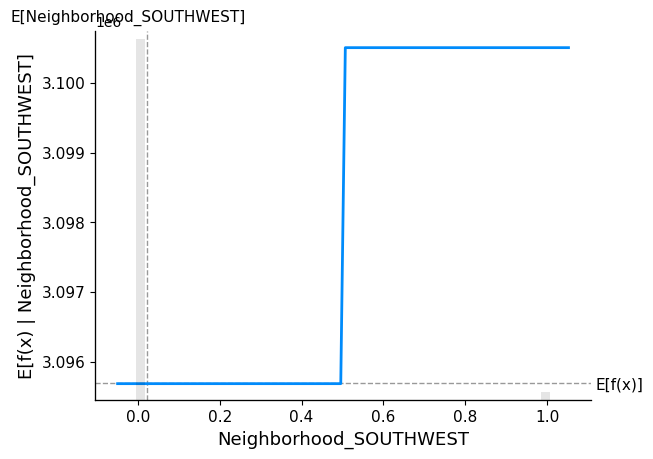

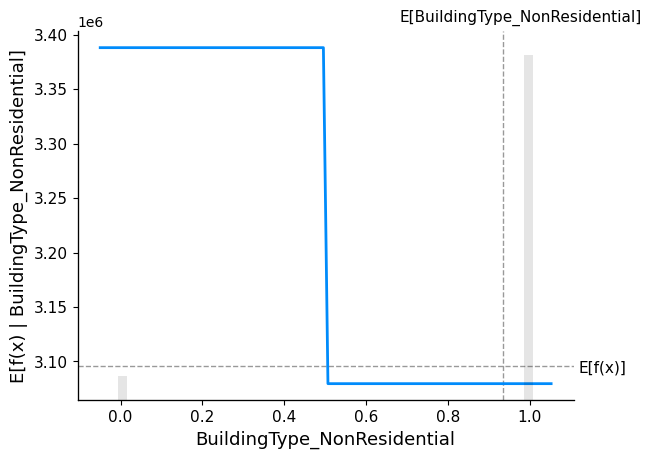

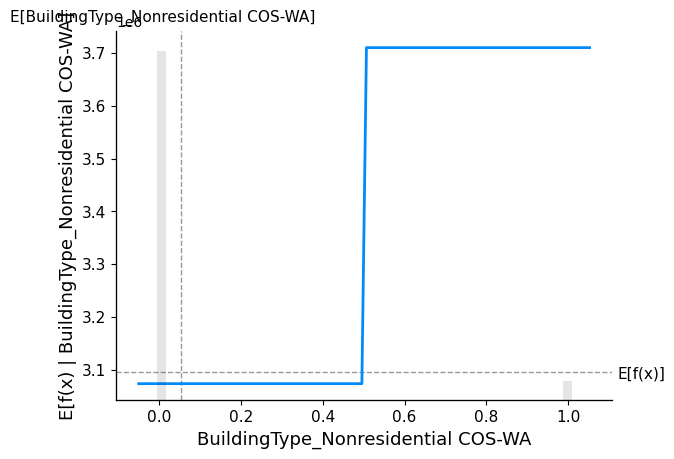

In [70]:
partial_dependence_plot(gradient_regression, features, X_train_trans)

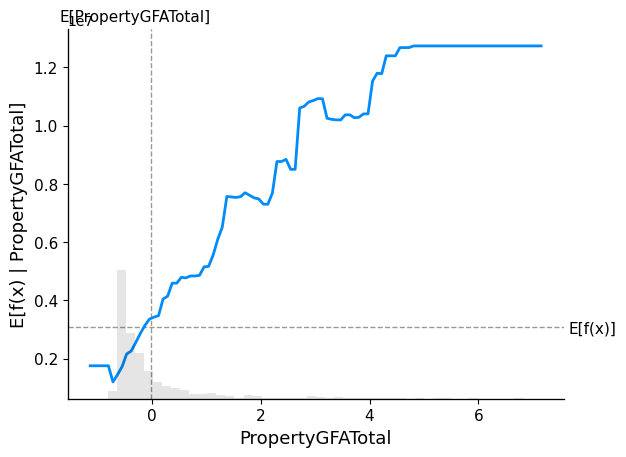

In [71]:
shap.plots.partial_dependence("PropertyGFATotal", gradient_regression.predict, X_train_trans, ice=False, model_expected_value=True, feature_expected_value=True)

<a id="dp"></a>

<h1 style="background-color:#82e0aa ;padding:18px;border-radius:10px;border:3px solid #3339ff;color:#21618c;text-align:center" >Model Building and Evaluation with ENERGYSTARSCORE</h1>

<a id="fp"></a>
## <span style="color:#33afff  ;"> Features Importance With ENERGYSTARSCORE imputed</span>

In [72]:
#  Define the selected features
selected_features = [
    'ENERGYSTARScore', 'LargestGFArate', 'MainEnergy', 'ParkingGFArate', 'PrimaryPropertyTypeNumberOfFloorProportion',
    'LargestPropertyUseType', 'PrimaryPropertyType', 'Neighborhood', 'ThirdUsage', 'BuildingType',
    'PrimaryGFAProportion', 'PropertyGFATotal'
]

# Filter out rows with zero 'SiteEnergyUseWN(kBtu)'
data = data[data['SiteEnergyUseWN(kBtu)'] != 0]


# Drop rows with missing values in 'SiteEnergyUseWN(kBtu)'
data = data.dropna(subset=['SiteEnergyUseWN(kBtu)'])

# Set the target variable
target = 'SiteEnergyUseWN(kBtu)'

# Select the features and target variable
df_ess_imp = data[selected_features]
y_ess_imp = data[target]

# Split the data into training and test sets
X_train_ess_imp, X_test_ess_imp, y_train_ess_imp, y_test_ess_imp = train_test_split(
    df_ess_imp, y_ess_imp, test_size=0.2, random_state=42
)

# Apply preprocessing to the training and test sets
X_train_ess_imp_trans = preprocessing(X_train_ess_imp)
X_test_ess_imp_trans = preprocessing(X_test_ess_imp)

print("The train set shape is {}".format(X_train_ess_imp_trans.shape))
print("The test set shape is {}".format(X_test_ess_imp_trans.shape))

# Iterate over the models dictionary
for model_name, model in models.items():
    print(model_name)
    model_testing(df_ess_imp, y_ess_imp, y_train_ess_imp, y_test_ess_imp, X_train_ess_imp, X_test_ess_imp, model)


The train set shape is (936, 49)
The test set shape is (235, 49)
Random Forest Regressor
The train score is: 0.9531993255070169
Model score: 0.756
MAE:  985302.60462
MSE:  1944667420613.9436
RMSE:  1394513.3275139192
MAPE:  0.55015
R²:  0.75637
Gradient Boosting Regressor
The train score is: 0.8716846130110717
Model score: 0.768
MAE:  980820.81058
MSE:  1851461266204.681
RMSE:  1360684.1169811166
MAPE:  0.54037
R²:  0.76805
Lasso
The train score is: 0.7365801029615416
Model score: 0.587
MAE:  1264948.31048
MSE:  3296935587137.901
RMSE:  1815746.5646774333
MAPE:  0.65546
R²:  0.58696
Ridge
The train score is: 0.735634120057666
Model score: 0.600
MAE:  1247729.05131
MSE:  3192245126833.809
RMSE:  1786685.5142508459
MAPE:  0.64404
R²:  0.60007
Elastic Net
The train score is: 0.6285292760065591
Model score: 0.582
MAE:  1358664.68691
MSE:  3335493531896.797
RMSE:  1826333.3572753898
MAPE:  0.87515
R²:  0.58212


In [73]:
# Define the categorical and numerical columns
CATEGORICAL = df_ess_imp.select_dtypes(include='object').columns
NUMERICAL = df_ess_imp.select_dtypes(include="number").columns

# Define the numerical pipeline
numerical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', RobustScaler())
])

# Define the categorical pipeline
categorical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
])

# Define the column transformer
preprocessors = ColumnTransformer(transformers=[
    ('num', numerical_pipe, NUMERICAL),
    ('cat', categorical_pipe, CATEGORICAL)
])


In [74]:
modelling(df_ess_imp, selected_features, estimators, X_train_ess_imp, X_test_ess_imp, y_train_ess_imp, y_test_ess_imp)

*************************************************************************************
                                        Dummy Regressor                                          
*************************************************************************************
Dummy Regressor
The train score is: 0.0
The test score is: -1.1609275611501602e-05
MAE = 2146857.61019
MSE = 7982129209215.83
RMSE = 2825266.21918
MAPE = 1.56697
R² = -1e-05
*************************************************************************************
                                        Elastic Net                                          
*************************************************************************************
Elastic Net
The train score is: 0.6285292760065591
The test score is: 0.5821249985894185
MAE = 1358664.68691
MSE = 3335493531896.797
RMSE = 1826333.35728
MAPE = 0.87515
R² = 0.58212
*************************************************************************************
                      

,Dummy Regressor,Elastic Net,SVR,Random Forest Regressor,Extra Tree Regressor,Gradient Boosting Regressor,KNeighbors Regressor,Linear Regression,Decision Tree Regressor,XGB Regressor,Lasso,Ridge,SGD Regressor,AdaBoost Regressor
R²,-0.000000e+00,5.821000e-01,-1.334000e-01,7.564000e-01,7.591000e-01,7.680000e-01,6.282000e-01,5.869000e-01,5.824000e-01,7.585000e-01,5.870000e-01,6.001000e-01,-2.830602e+04,4.279000e-01
MAE,2.146858e+06,1.358665e+06,1.986884e+06,9.853026e+05,9.965690e+05,9.808208e+05,1.241084e+06,1.265207e+06,1.310685e+06,9.797191e+05,1.264948e+06,1.247729e+06,3.041117e+08,1.913987e+06
RMSE,2.825266e+06,1.826333e+06,3.007844e+06,1.394513e+06,1.386807e+06,1.360684e+06,1.722698e+06,1.815922e+06,1.825751e+06,1.388419e+06,1.815747e+06,1.786686e+06,4.753395e+08,2.136852e+06
MAPE,1.567000e+00,8.752000e-01,9.949000e-01,5.502000e-01,5.158000e-01,5.404000e-01,6.479000e-01,6.557000e-01,6.200000e-01,5.112000e-01,6.555000e-01,6.440000e-01,2.366285e+02,1.784900e+00


In [75]:
model_pipe_ess_imp = Pipeline([('preprocessors', preprocessors),
                ('regressor',  GradientBoostingRegressor(random_state=42))])

In [76]:
model_params = { 'Random Forest Regressor': rfr_grid, 
               'Gradient Boosting Regressor':gbr_grid,
                                 }

In [77]:
tuning_model = 'GridSearchCV'
searchCV_ess_imp, score_table_ess_imp = search_tuning(model_pipe_ess_imp, X_train_ess_imp,
                                      X_test_ess_imp, y_train_ess_imp,
                                      y_test_ess_imp, model_params, 
                                      kf, tuning_model)


*************************************************************************************
                Proceding GridSearchCV for Random Forest Regressor...                
*************************************************************************************
Fitting 5 folds for each of 165 candidates, totalling 825 fits

Best GridSearchCV hyperparameters for Random Forest Regressor:
max_depth: 15
max_features: auto
n_estimators: 500
_________________________________________________________________________________________________________
| Mean cross-validated score of the best estimator for Random Forest Regressor: R² = 0.670 ± 0.050 |
|_________________________________________________________________________________________________________|
*************************************************************************************
              Proceding GridSearchCV for Gradient Boosting Regressor...              
*****************************************************************************

In [78]:
grid_best_model_ess_imp = get_best_model(searchCV_ess_imp)


The overall best cross-validated score is: R² = 0.715
The best model is Gradient Boosting Regressor with parameters:
  - learning_rate: 0.02
  - max_depth: 2
  - n_estimators: 800
  - subsample: 0.7


In [79]:
grid_best_model_ess_imp

Pipeline(steps=[('preprocessors',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   RobustScaler())]),
                                                  Index(['ENERGYSTARScore', 'LargestGFArate', 'ParkingGFArate',
       'PrimaryPropertyTypeNumberOfFloorProportion', 'PrimaryGFAProportion',
       'PropertyGFATotal'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleIm...='missing',
                                                                                 strategy='constant')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore',
                                                                                 sparse=False))]),
                                                  Index(['MainEnergy', 'LargestPropertyUseType', 'PrimaryPropertyType',
       'Neighborhood', 'BuildingType'],
      dtype='object'))])),
                ('regressor',
                 GradientBoostingRegressor(learning_rate=0.02, max_depth=2,
                                           n_estimators=800, random_state=42,
                                           subsample=0.7))])

In [80]:
grid_best_model_ess_imp.fit(X_train_ess_imp, y_train_ess_imp)

Pipeline(steps=[('preprocessors',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   RobustScaler())]),
                                                  Index(['ENERGYSTARScore', 'LargestGFArate', 'ParkingGFArate',
       'PrimaryPropertyTypeNumberOfFloorProportion', 'PrimaryGFAProportion',
       'PropertyGFATotal'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleIm...='missing',
                                                                                 strategy='constant')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore',
                                                                                 sparse=False))]),
                                                  Index(['MainEnergy', 'LargestPropertyUseType', 'PrimaryPropertyType',
       'Neighborhood', 'BuildingType'],
      dtype='object'))])),
                ('regressor',
                 GradientBoostingRegressor(learning_rate=0.02, max_depth=2,
                                           n_estimators=800, random_state=42,
                                           subsample=0.7))])

In [81]:
# Evaluate the model's performance on the test data
print("Test score is:", grid_best_model_ess_imp.score(X_test_ess_imp, y_test_ess_imp))

# Evaluate the model's performance on the training data
print("Train score is:", grid_best_model_ess_imp.score(X_train_ess_imp, y_train_ess_imp))

Test score is: 0.7579252659225132
Train score is: 0.8449436983749683


In [82]:
def objective(space):
    """
    Objective function for hyperparameter optimization using Bayesian optimization.

    Args:
        space (dict): Hyperparameter configuration space.

    Returns:
        Dictionary containing the loss (negative RMSE) and status.

    """
    shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)  # ShuffleSplit for cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)  # KFold for cross-validation
    estimator_clone = clone(pipe).set_params(**space)  # Create a clone of the pipeline with hyperparameters set
    scores = cross_val_score(estimator_clone, X_train_ess_imp, y_train_ess_imp, cv=kfold,
                             scoring='neg_root_mean_squared_error', n_jobs=-1)  # Perform cross-validation
    loss = -1 * np.mean(scores)  # Calculate the negative mean RMSE loss
    return {'loss': loss, 'status': STATUS_OK}

In [83]:
# Define the search space for hyperparameters
param_grid = {
    "regressor__max_depth": hp.randint('max_depth', 1, 8),
    "regressor__learning_rate": hp.uniform('learning_rate', 0.01, 1),
    "regressor__n_estimators": 100 + hp.randint("n_estimators", 1500),
    "regressor__subsample": hp.uniform('subsample', 0.01, 1),
    "regressor__min_samples_split": hp.randint("min_samples_split", 2, 40),
    "regressor__min_samples_leaf": hp.randint("min_samples_leaf", 1, 40)
}

# Define the pipeline with preprocessors and a GradientBoostingRegressor
model_pipe_ess_imp = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

shuffle = ShuffleSplit(n_splits=10, test_size=0.2, random_state=42)  # ShuffleSplit for cross-validation

tpe_trials = Trials()  # Create an instance of Trials to track the optimization process

# Perform hyperparameter optimization using TPE algorithm
best = fmin(objective,
            space=param_grid,
            algo=tpe.suggest,
            max_evals=200,
            rstate=np.random.default_rng(42),
            trials=tpe_trials)

print(best)  # Print the best hyperparameters found during optimization

100%|██████████████████████████████████████████████| 200/200 [11:15<00:00,  3.38s/trial, best loss: 1684792.5728850719]
{'learning_rate': 0.017064759616496592, 'max_depth': 4, 'min_samples_leaf': 8, 'min_samples_split': 13, 'n_estimators': 489, 'subsample': 0.4824912196918294}


In [84]:
# Create a pipeline with preprocessors and a GradientBoostingRegressor using the best hyperparameters
model = Pipeline([
    ('preprocessors', preprocessors),
    ('regressor', GradientBoostingRegressor(**best, random_state=42))
])

# Fit the model on the training data
model.fit(X_train_ess_imp, y_train_ess_imp)

# Evaluate the model's performance on the test data
test_score = model.score(X_test_ess_imp, y_test_ess_imp)
print("Test score is:", test_score)

# Evaluate the model's performance on the training data
train_score = model.score(X_train_ess_imp, y_train_ess_imp)
print("Train score is:", train_score)

Test score is: 0.7585452109418288
Train score is: 0.8504075378532245


<a id="fp"></a>
## <span style="color:#33afff  ;"> Features Importance With ENERGYSTARSCORE</span>

In [85]:
# Define the selected features
selected_features = ['ENERGYSTARScore', 'LargestGFArate', 'MainEnergy', 'ParkingGFArate',
                     'PrimaryPropertyTypeNumberOfFloorProportion', 'LargestPropertyUseType',
                     'PrimaryPropertyType', 'Neighborhood', 'ThirdUsage', 'BuildingType',
                     'PrimaryGFAProportion', 'PropertyGFATotal']

# Remove rows with zero values in 'SiteEnergyUseWN(kBtu)'
data = data[data['SiteEnergyUseWN(kBtu)'] != 0]

# Compute the natural logarithm of 'SiteEnergyUseWN(kBtu)' and create a new column 'log_cons'
data["log_cons"] = np.log(data['SiteEnergyUseWN(kBtu)'])

# Drop rows with missing values in 'SiteEnergyUseWN(kBtu)'
data = data.dropna(subset=['SiteEnergyUseWN(kBtu)'])

# Create a copy of the dataset and drop rows with missing values in 'ENERGYSTARScore'
df = data.copy()
df = df.dropna(subset=['ENERGYSTARScore'])

# Select the features and the target variable
df_ess = df[selected_features]
y_ess = df['SiteEnergyUseWN(kBtu)']

# Split the dataset into training and testing sets
X_train_ess, X_test_ess, y_train_ess, y_test_ess = train_test_split(df_ess, y_ess, test_size=0.2, random_state=42)

# Perform preprocessing on the selected features
df_ess_trans = preprocessing(df_ess)

# Split the preprocessed dataset into training and testing sets
X_train_ess_trans, X_test_ess_trans, y_train_trans_ess, y_test_trans_ess = train_test_split(df_ess_trans, y_ess, test_size=0.2, random_state=42)

# Print the shapes of the training and testing sets
print("The train set shape is {}".format(X_train_ess_trans.shape))
print("The test set shape is {}".format(X_test_ess_trans.shape))

# Iterate over the models dictionary and perform model testing
for model_name, model in models.items():
    print(model_name)
    model_testing(df_ess, y_ess, y_train_ess, y_test_ess, X_train_ess, X_test_ess, model)


The train set shape is (610, 42)
The test set shape is (153, 42)
Random Forest Regressor
The train score is: 0.9729568960263466
Model score: 0.841
MAE:  1031372.27385
MSE:  2370623206261.145
RMSE:  1539682.826513677
MAPE:  0.39847
R²:  0.84132
Gradient Boosting Regressor
The train score is: 0.9482371681929165
Model score: 0.851
MAE:  998336.75733
MSE:  2226383918309.951
RMSE:  1492107.2073781935
MAPE:  0.37931
R²:  0.85098
Lasso
The train score is: 0.8089010489173665
Model score: 0.793
MAE:  1210778.08548
MSE:  3092247632282.556
RMSE:  1758478.7835747567
MAPE:  0.52395
R²:  0.79302
Ridge
The train score is: 0.808391244785254
Model score: 0.794
MAE:  1210862.76938
MSE:  3071438204577.0664
RMSE:  1752551.9120919262
MAPE:  0.52404
R²:  0.79442
Elastic Net
The train score is: 0.6413661035976849
Model score: 0.696
MAE:  1481759.88408
MSE:  4537595192909.284
RMSE:  2130163.1845727884
MAPE:  0.77656
R²:  0.69628


In [86]:
# Define the categorical and numerical columns
CATEGORICAL = df_ess.select_dtypes(include='object').columns
NUMERICAL = df_ess.select_dtypes(include="number").columns

# Define the numerical pipeline
numerical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', RobustScaler())
])

# Define the categorical pipeline
categorical_pipe = Pipeline([
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('encoder', OneHotEncoder(drop='first', handle_unknown='ignore', sparse=False))
])

# Define the column transformer
preprocessors = ColumnTransformer(transformers=[
    ('num', numerical_pipe, NUMERICAL),
    ('cat', categorical_pipe, CATEGORICAL)
])


In [87]:
modelling(df_ess, selected_features, estimators, X_train_ess, X_test_ess, y_train_ess, y_test_ess)

*************************************************************************************
                                        Dummy Regressor                                          
*************************************************************************************
Dummy Regressor
The train score is: 0.0
The test score is: -0.023566677654299983
MAE = 2646045.45091
MSE = 15292099920289.941
RMSE = 3910511.46531
MAPE = 1.46867
R² = -0.02357
*************************************************************************************
                                        Elastic Net                                          
*************************************************************************************
Elastic Net
The train score is: 0.6413661035976849
The test score is: 0.6962790420965143
MAE = 1481759.88408
MSE = 4537595192909.284
RMSE = 2130163.18457
MAPE = 0.77656
R² = 0.69628
*************************************************************************************
                    

,Dummy Regressor,Elastic Net,SVR,Random Forest Regressor,Extra Tree Regressor,Gradient Boosting Regressor,KNeighbors Regressor,Linear Regression,Decision Tree Regressor,XGB Regressor,Lasso,Ridge,SGD Regressor,AdaBoost Regressor
R²,-2.360000e-02,6.963000e-01,-1.866000e-01,8.413000e-01,8.331000e-01,8.510000e-01,6.896000e-01,7.930000e-01,7.514000e-01,8.211000e-01,7.930000e-01,7.944000e-01,-7.492945e+04,7.655000e-01
MAE,2.646045e+06,1.481760e+06,2.527135e+06,1.031372e+06,1.020460e+06,9.983368e+05,1.373432e+06,1.210743e+06,1.318810e+06,1.070158e+06,1.210778e+06,1.210863e+06,6.787731e+08,1.565501e+06
RMSE,3.910511e+06,2.130163e+06,4.210408e+06,1.539683e+06,1.579234e+06,1.492107e+06,2.153496e+06,1.758536e+06,1.927080e+06,1.634774e+06,1.758479e+06,1.752552e+06,1.058046e+09,1.871871e+06
MAPE,1.468700e+00,7.766000e-01,9.425000e-01,3.985000e-01,3.725000e-01,3.793000e-01,5.654000e-01,5.239000e-01,5.136000e-01,3.990000e-01,5.239000e-01,5.240000e-01,3.676044e+02,1.148400e+00


In [88]:
model_pipe_ess = Pipeline([('preprocessors', preprocessors),
                ('regressor',  GradientBoostingRegressor(random_state=42))])

In [89]:
tuning_model = 'GridSearchCV'
searchCV_ess, score_table_ess = search_tuning(model_pipe_ess, X_train_ess,
                                                      X_test_ess, y_train_ess,
                                                      y_test_ess, model_params, 
                                                      kf, tuning_model)


*************************************************************************************
                Proceding GridSearchCV for Random Forest Regressor...                
*************************************************************************************
Fitting 5 folds for each of 165 candidates, totalling 825 fits

Best GridSearchCV hyperparameters for Random Forest Regressor:
max_depth: 30
max_features: auto
n_estimators: 100
_________________________________________________________________________________________________________
| Mean cross-validated score of the best estimator for Random Forest Regressor: R² = 0.810 ± 0.036 |
|_________________________________________________________________________________________________________|
*************************************************************************************
              Proceding GridSearchCV for Gradient Boosting Regressor...              
*****************************************************************************

In [90]:
grid_best_model_ess = get_best_model(searchCV_ess)
grid_best_model_ess


The overall best cross-validated score is: R² = 0.854
The best model is Gradient Boosting Regressor with parameters:
  - learning_rate: 0.01
  - max_depth: 5
  - n_estimators: 1000
  - subsample: 0.3


Pipeline(steps=[('preprocessors',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   RobustScaler())]),
                                                  Index(['ENERGYSTARScore', 'LargestGFArate', 'ParkingGFArate',
       'PrimaryPropertyTypeNumberOfFloorProportion', 'PrimaryGFAProportion',
       'PropertyGFATotal'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleIm...'missing',
                                                                                 strategy='constant')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore',
                                                                                 sparse=False))]),
                                                  Index(['MainEnergy', 'LargestPropertyUseType', 'PrimaryPropertyType',
       'Neighborhood', 'BuildingType'],
      dtype='object'))])),
                ('regressor',
                 GradientBoostingRegressor(learning_rate=0.01, max_depth=5,
                                           n_estimators=1000, random_state=42,
                                           subsample=0.3))])

In [91]:
# Evaluate the model's performance on the test data
print("Test score is:", grid_best_model_ess.score(X_test_ess, y_test_ess))

# Evaluate the model's performance on the training data
print("Train score is:", grid_best_model_ess.score(X_train_ess, y_train_ess))

Test score is: 0.8660771463285988
Train score is: 0.9751433233688931


The overall best cross-validated score is : R² = 0.854
The best model is Gradient Boosting Regressor with parameters: 
  - learning_rate: 0.01
  - max_depth: 5
  - n_estimators: 1000
  - subsample: 0.3

In [92]:
# Instantiate a GradientBoostingRegressor model with specified hyperparameters
gradient_ess = GradientBoostingRegressor(
    learning_rate=0.01,
    max_depth=5,
    n_estimators=1000,
    random_state=42,
    subsample=0.3
)

# Fit the model on the training data
gradient_ess.fit(X_train_ess_trans, y_train_trans_ess)

# Calculate and print the test score
test_score = gradient_ess.score(X_test_ess_trans, y_test_trans_ess)
print("Test score is:", test_score)

# Calculate and print the train score
train_score = gradient_ess.score(X_train_ess_trans, y_train_trans_ess)
print("Train score is:", train_score)


Test score is: 0.8667018203400499
Train score is: 0.9752764066323483


In [93]:
features= X_train_ess_trans.columns.values.tolist()

explainer = lime_tabular.LimeTabularExplainer(X_train_ess_trans.values, mode="regression",
                                              feature_names= X_train_ess_trans.columns.values.tolist(),
                                              class_names=['SiteEnergyUseWN(kBtu)'], verbose=True,)

In [94]:
# Generate a random index
j = np.random.randint(1, len(X_test_ess_trans))

# Print the selected index
print("j =", j)

# Explain the instance using the explainer
exp = explainer.explain_instance(X_test_ess_trans.values[j], gradient_ess.predict, num_features=len(features))

j = 43
Intercept 9946484.55803607
Prediction_local [2421031.56910874]
Right: 772955.3689620236


Intercept 5491516.613069879
Prediction_local [5366203.735504]
Right: 8742657.686820878
test index: 78
Explanation Local Prediction  :  [5366203.735504]
Explanation Global Prediction :  8742657.686820878


(<lime.explanation.Explanation at 0x1fbac25e230>,
 [('-0.57 < PropertyGFATotal <= -0.37', -2264316.970212289),
  ('ENERGYSTARScore <= -0.61', 1339854.3102044896),
  ('PrimaryPropertyType_Supermarket / Grocery Store > 0.00',
   1185237.3682000213),
  ('LargestPropertyUseType_Finance <= 0.00', 1033965.1855089881),
  ('PrimaryPropertyType_Warehouse <= 0.00', 973712.4169248543),
  ('LargestPropertyUseType_Supermarket/Grocery Store > 0.00',
   829758.3213242049),
  ('LargestPropertyUseType_Senior Care Community <= 0.00', -695009.8635650058),
  ('PrimaryPropertyType_Large Office <= 0.00', -609240.5216960472),
  ('Neighborhood_DELRIDGE <= 0.00', -580467.1367611013),
  ('LargestPropertyUseType_Parking <= 0.00', -579957.5222403221),
  ('MainEnergy_NaturalGas <= 0.00', -579398.3844842955),
  ('PrimaryPropertyType_Mixed Use Property <= 0.00', 500579.7627331513),
  ('MainEnergy_Steam <= 0.00', -483040.38471325807),
  ('BuildingType_Nonresidential COS-WA <= 0.00', 473216.0146351758),
  ('Neighborho

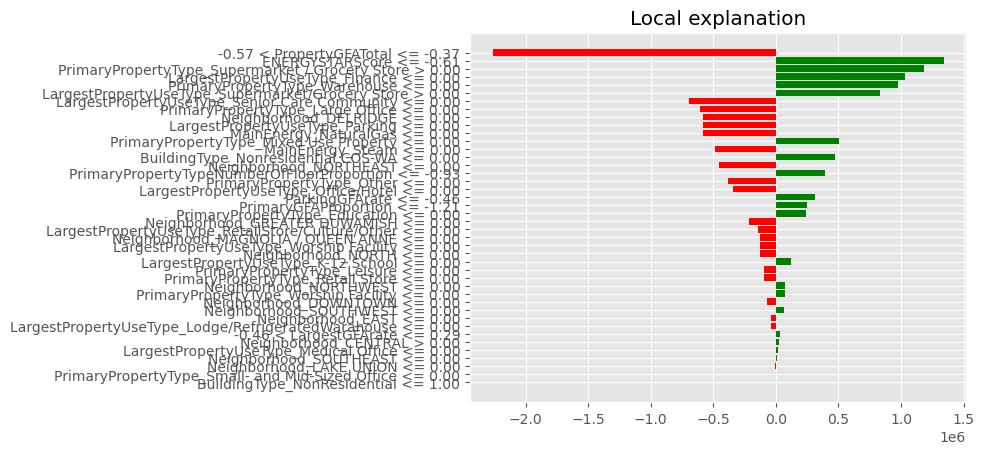

In [95]:
explanation_point(gradient_ess, features, X_test_ess_trans, y_test_trans_ess, idx = np.random.randint(1, len(X_test_ess_trans)))

In [96]:
def shape_explainer_check(model, features: List[str], X_train: pd.DataFrame, X_test: pd.DataFrame,
                          Y_test: pd.Series, idx: int = np.random.randint(1, len(X_test)), max_display: int = 10):
    """
    Analyzes and visualizes feature importances and model explanations using SHAP (SHapley Additive exPlanations) library.

    Args:
        model: The trained model object.
        features: A list of feature names.
        X_train: The training dataset.
        X_test: The testing dataset.
        Y_test: The ground truth target for the testing dataset.
        idx: The index of the test sample to explain. Defaults to a random index.
        max_display: The maximum number of features to display in the waterfall plot. Defaults to 10.

    Returns:
        None
    """

    print("test index:", idx)

    # Create SHAP explainer
    explainer = shap.TreeExplainer(model, X_train, feature_names=features)

    # SHAP bar plot
    print("Shap bar plot")
    shap.bar_plot(explainer.shap_values(X_test.iloc[0]), feature_names=features)

    # SHAP waterfall plot
    print("Waterfall plot")
    shap_values = explainer(X_test[:idx], check_additivity=False)
    shap_values.feature_names = features
    shap.waterfall_plot(shap_values[0], max_display=max_display)

    # SHAP decision plot
    print("Decision plot")
    shap.decision_plot(explainer.expected_value, explainer.shap_values(X_test.iloc[idx]), feature_names=features)

    # SHAP decision plot for multiple samples
    print("Decision plot for multiple samples")
    shap.decision_plot(explainer.expected_value, explainer.shap_values(X_test[0:5], check_additivity=False),
                       feature_names=features, highlight=[1, 2])

    # SHAP force plot
    print("Force plot")
    shap.force_plot(explainer.expected_value, explainer.shap_values(X_test.iloc[idx], check_additivity=False),
                    feature_names=features, out_names="Energy consumption")

    shap.force_plot(explainer.expected_value, explainer.shap_values(X_test[0:10], check_additivity=False),
                    feature_names=features, out_names="Energy consumption", figsize=(25, 3), link="identity")

    # SHAP summary plot
    print("Summary plot")
    shap.summary_plot(explainer.shap_values(X_test, check_additivity=False), feature_names=features,
                      plot_type="bar", color="dodgerblue")

    shap.summary_plot(explainer.shap_values(X_test, check_additivity=False), feature_names=features,
                      plot_type="violin", color="tomato")

In [97]:
grad_ess_explainer = shap.TreeExplainer(gradient_ess, X_train_ess_trans, feature_names=features)
grad_ess_explainer

test index: 15
Shap bar plot


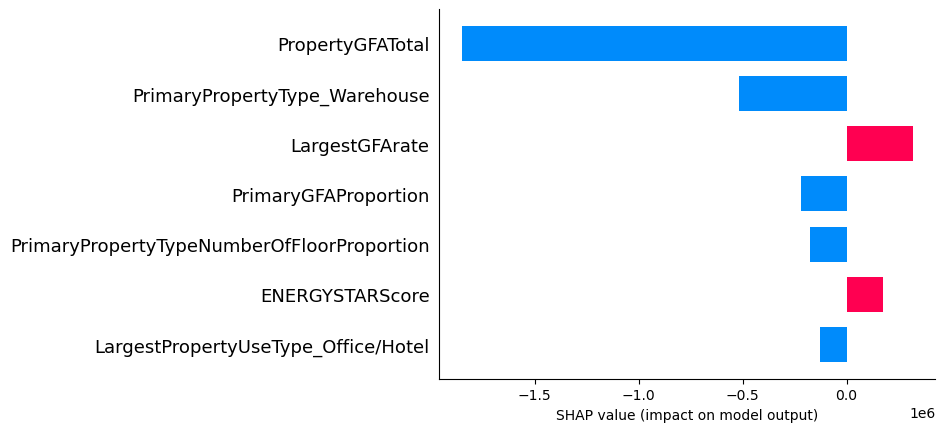

Waterfall plot


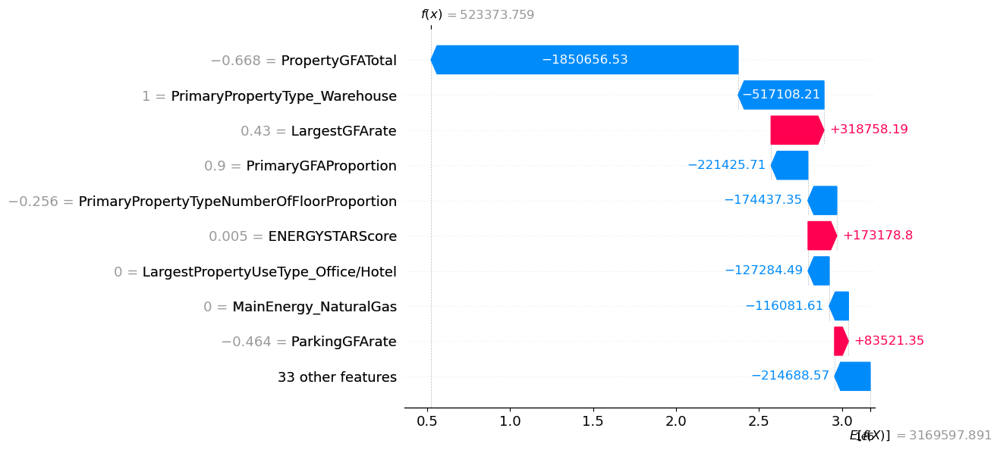

Decision plot


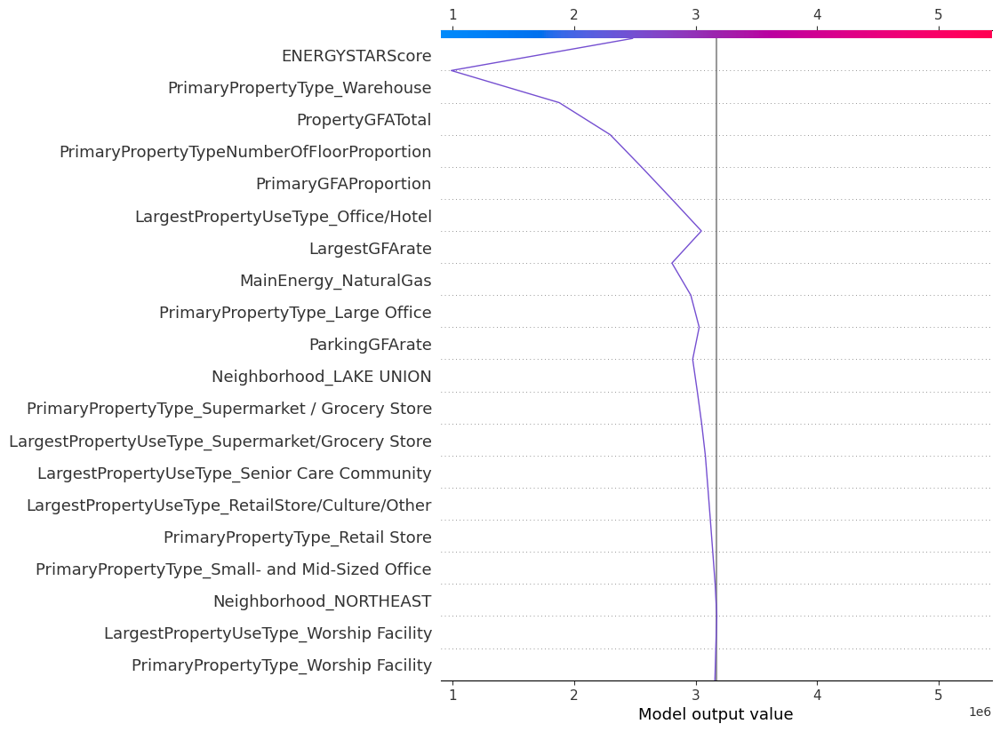

Decision plot for multiple samples


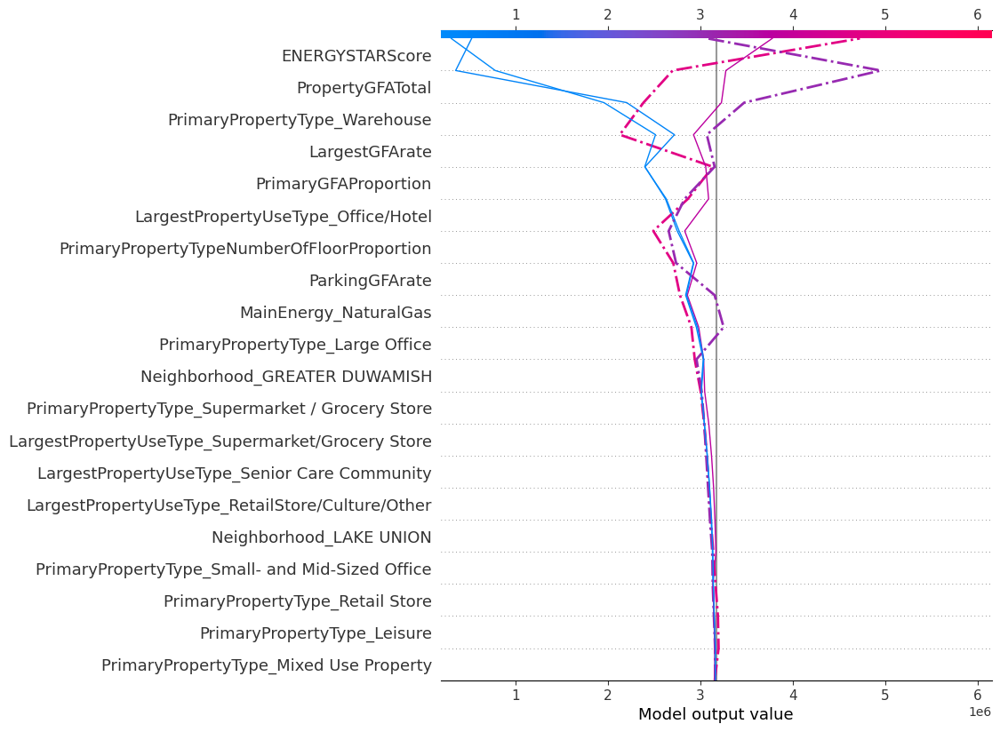

Force plot
Summary plot


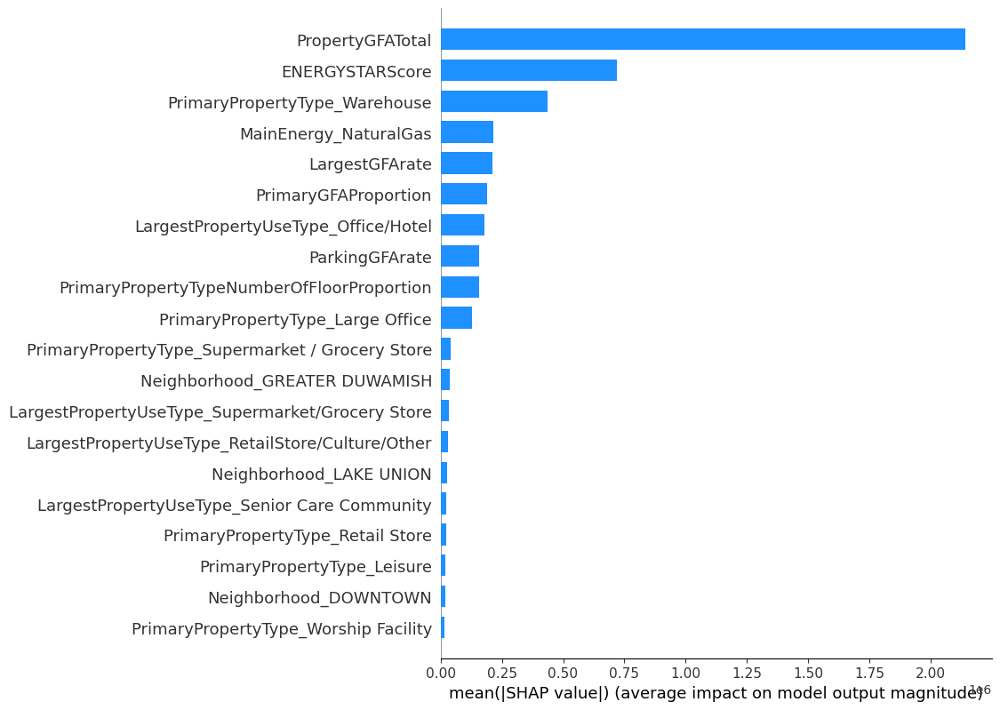

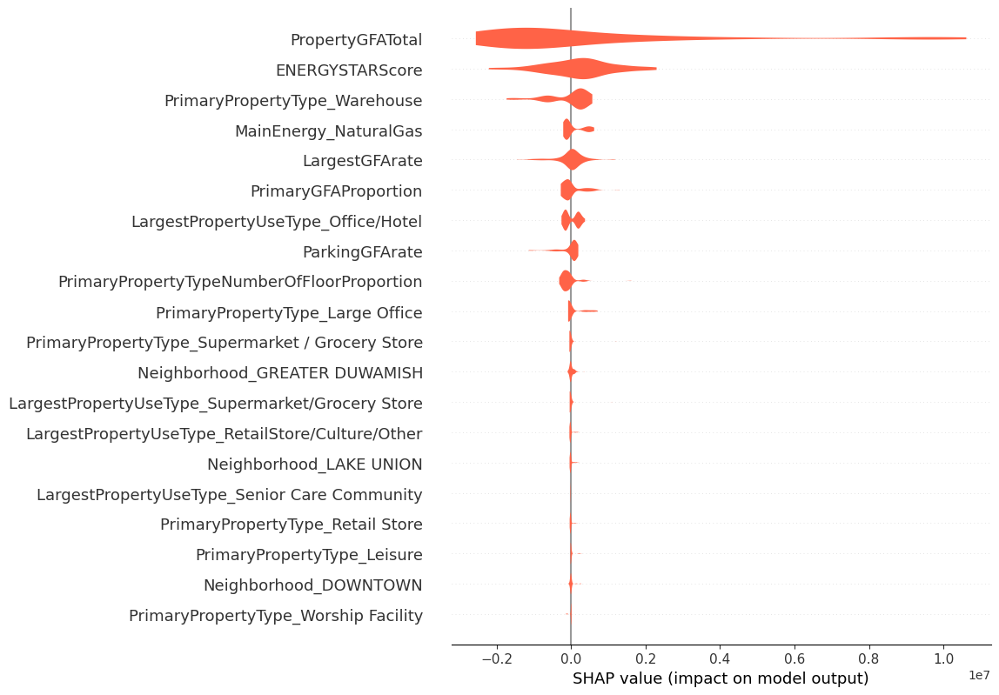

In [98]:
shape_explainer_check(gradient_ess, features,X_train_ess_trans, X_test_ess_trans, y_test_trans_ess, idx = np.random.randint(1, len(X_test_ess_trans)),max_display=10)

In [99]:
   shap.force_plot(grad_ess_explainer.expected_value,
                grad_ess_explainer.shap_values(X_test_ess_trans[0:20],  check_additivity=False),
                feature_names=features,
                out_names="Energy consumption", figsize=(25,3),
                link="identity")

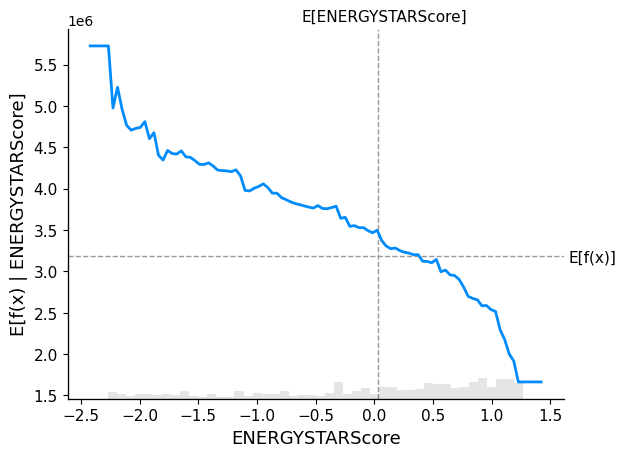

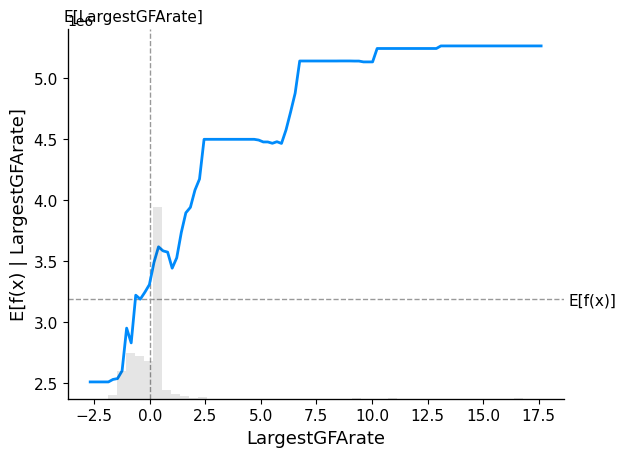

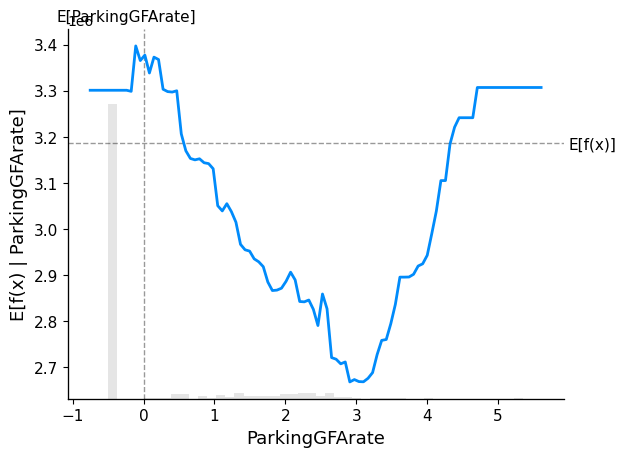

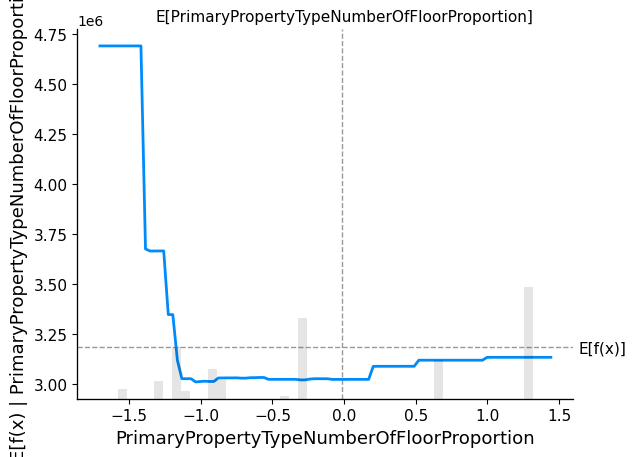

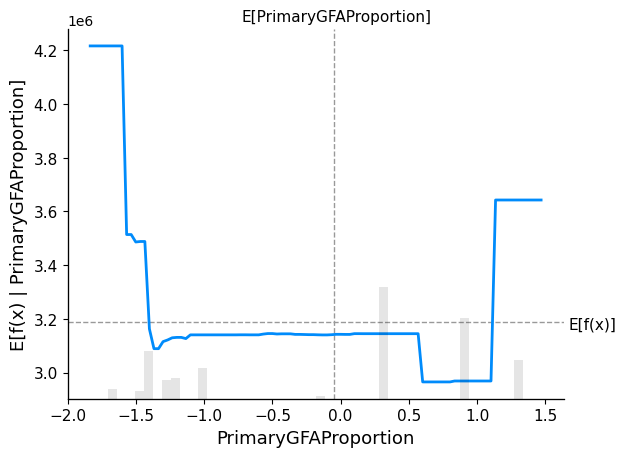

...

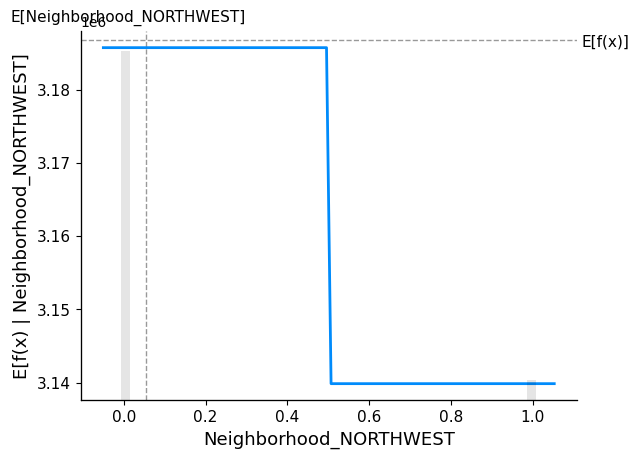

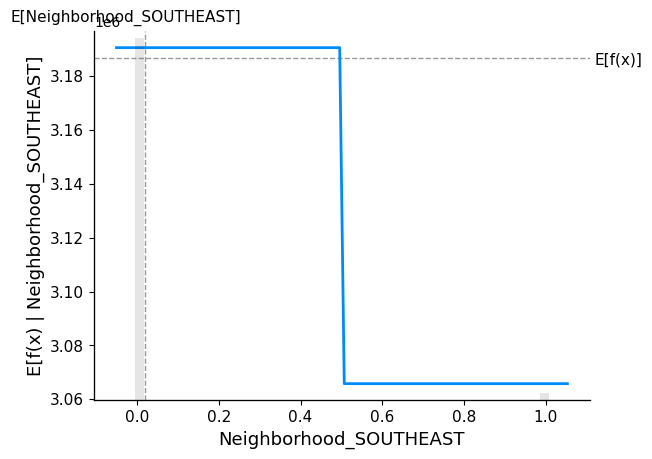

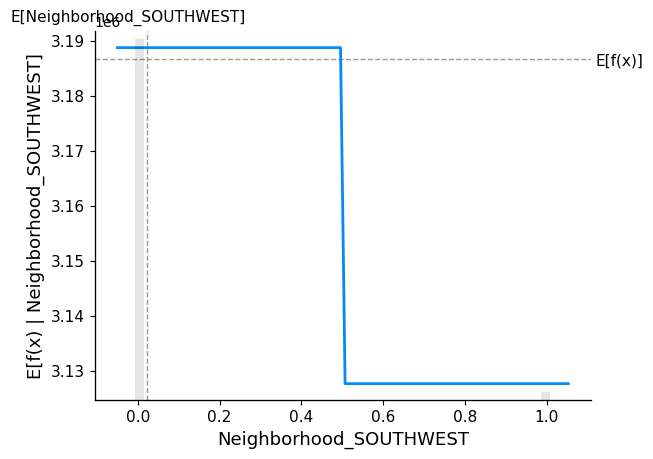

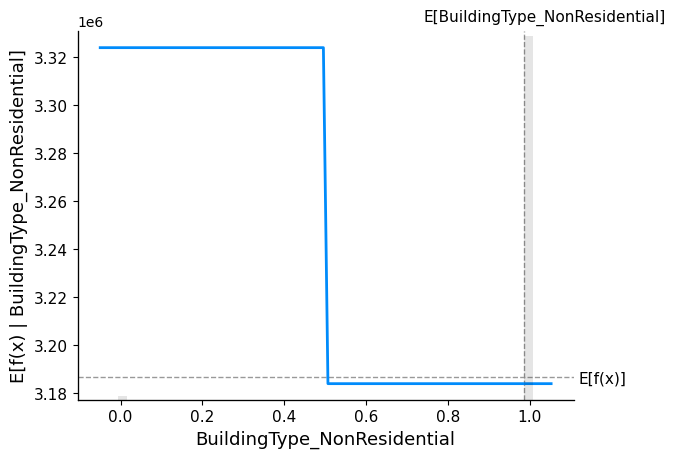

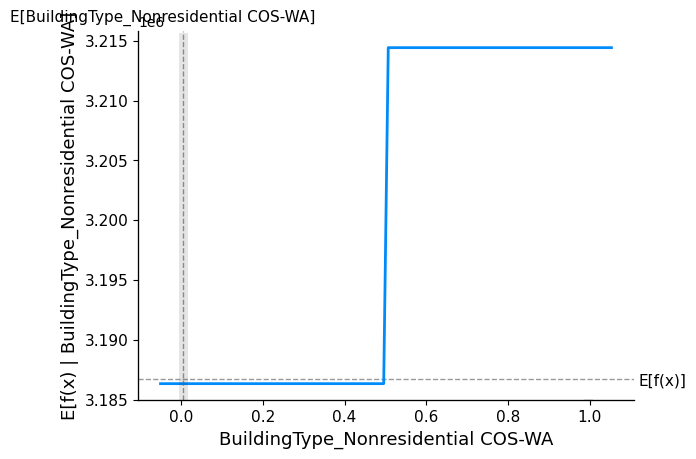

In [100]:
partial_dependence_plot(gradient_ess, features, X_train_ess_trans)

**Energystarscore improve very well our model**

<a id="IR"></a>
<h1 style="background-color:#82e0aa ;padding:18px;border-radius:10px;border:3px solid #3339ff;color:#21618c;text-align:center" > Conclusion </h1>


The current estimation results are not satisfactory for deployment. To enhance the model's performance, we need to revisit the dataset and engage in new feature engineering techniques that reduce the number of categorical features. This will effectively address the overfitting issue and improve the model's generalization capabilities.